<h2>2<sup>η</sup> Εργαστηριακή Άσκηση</h2>

## Ανάλυση & Μελέτη Σύνθετων Τοπολογιών Δικτύου
## Μπάρμπα Παναγιώτα-Νικολέττα
## ΑΜ: 03118604
<h3>Ανάλυση Κοινωνικής Δομής σε Τεχνητές και Πραγματικές Σύνθετες Τοπολογίες Δικτύων</h3>
<p style=text-align:justify>Στην παρούσα άσκηση θα αναλυθούν τεχνητές και πραγματικές τοπολογίες σύνθετων δικτύων με βάση τις μετρικές που χρησιμοποιήθηκαν στην προηγούμενη άσκηση και κάποιες τεχνικές που έχουν ως στόχο την εύρεση κοινωνικής δομής. Συγκεκριμένα, θα χρησιμοποιηθούν και θα συγκριθούν διάφοροι αλγόριθμοι εντοπισμού κοινοτήτων σε γράφους δικτύων που προκύπτουν από πραγματικά δεδομένα καθώς και στους συνθετικούς γράφους της πρώτης εργαστηριακής άσκησης.</p>

In [245]:
%matplotlib inline

import matplotlib
import networkx as nx
import random
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
from sklearn.cluster import SpectralClustering


import warnings
warnings.filterwarnings('ignore')

<h3>Α. Μελέτη πραγματικών τοπολογιών</h3>
<p style=text-align:justify>Στο παρόν ερώτημα θα μελετήσετε και θα αποκτήσετε αίσθηση της τοπολογικής δομής πραγματικών δικτύων. Πιο συγκεκριμένα, για τις τοπολογίες που φαίνονται στον <b>πίνακα 1</b>, να βρεθούν και να δειχθούν:</p>
<ol>
    <li>Η κατανομή του βαθμού κόμβου και ο μέσος βαθμός κάθε τοπολογίας.</li>
    <li>Η κατανομή του συντελεστή ομαδοποίησης κόμβου και ο μέσος συντελεστής ομαδοποίησης κάθε τοπολογίας.</li>
    <li>Η κατανομή της κεντρικότητας εγγύτητας και η μέση κεντρικότητα εγγύτητας κάθε τοπολογίας.</li>
</ol>
<p style=text-align:justify>Να συγκριθούν τα αποτελέσματα σε σχέση με αυτά των συνθετικών τοπολογιών. Να χαρακτηρίσετε τον τύπο κάθε μίας από τις πραγματικές τοπολογίες με βάση τους τύπους δικτύων που εξετάστηκαν στην πρώτη εργαστηριακή άσκηση.</p>

<table style=width:100%>
    <caption>Πίνακας <b>1</b>: Πραγματικές τοπολογίες</a></caption>
<tr>
    <th style=text-align:left>Τοπολογία</th>
    <th style=text-align:left>Αρχείο</th>
    <th style=text-align:left>Περιγραφή</th>
</tr>
<tr>
    <td style=text-align:left>American College Football</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/football.zip'>football.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>football.gml</b> contains the network of American football games between Division IA colleges during regular season Fall 2000, as compiled by M. Girvan and M. Newman. The nodes have values that indicate to which conferences they belong.</p>
    </td>
</tr>  
<tr>
    <td style=text-align:left>Game of Thrones - season 5</td>
    <td style=text-align:left><a style=text-decoration:none href='https://networkofthrones.wordpress.com/the-series/season-5/'>GoT</a></td>
    <td style=text-align:left><p style=text-align:justify> The season 5 <b>GoT</b> network represents the interactions between the characters of Game of Thrones in season 5. The season 5 network has 118 nodes (characters) and 394 weighted edges, corresponding to 5,139 interactions. Data can be found here: <a style=text-decoration:none href='https://raw.githubusercontent.com/mathbeveridge/gameofthrones/master/data/got-s5-edges.csv'>GoT_data</a></p>
</tr> 
<tr>
    <td style=text-align:left>email-Eu-core</td>
    <td style=text-align:left><a style=text-decoration:none href='https://snap.stanford.edu/data/email-Eu-core.html'>email-eu-core</a></td>
    <td style=text-align:left><p style=text-align:justify> The network <b>email-Eu-core</b> was generated using email data from a large European research institution. There is an edge (u, v) in the network if person u sent person v at least one email. The e-mails only represent communication between institution members (the core) and the dataset does not contain incoming messages from or outgoing messages to the rest of the world. The dataset also contains "ground-truth" community memberships of the nodes. Each individual belongs to exactly one of 42 departments at the research institute. </p>
</tr> 
    
</table>

<h4>Παραγωγή συνθετικών τοπολογιών</h4> 
<p>Προσοχή! Τα δίκτυα που θα παράξετε θα πρέπει να είναι συνδεδεμένα.</p>

In [246]:
n = 80
d = 4
M = 300
R = 0.25
p = 0.3
k = 4
seedno = 5
random.seed(seedno)

REG = nx.watts_strogatz_graph(n = n, k = k, p  = 0, seed = seedno)
RGER = nx.gnm_random_graph(n = n, m = M, seed = seedno)
RGG = nx.random_geometric_graph(n = n, radius = R, seed = seedno)
RGGil = nx.gnp_random_graph(n = n, p = p, seed = seedno)
SF = nx.barabasi_albert_graph(n = n, m = d, seed = seedno)
SW = nx.watts_strogatz_graph(n = n, k = k, p = p, seed = seedno)

Graphs = {'REG' : REG, 'RGER' : RGER, 'RGG' : RGG, 'RGGil' : RGGil, 'SF' : SF, 'SW' : SW }
# check all graphs are connected
for name, graph in Graphs.items():
    print(name,"is connected?", nx.is_connected(graph))

REG is connected? True
RGER is connected? True
RGG is connected? True
RGGil is connected? True
SF is connected? True
SW is connected? True


<h4>Εισαγωγή και οπτικοποίηση πραγματικών τοπολογιών.</h4>

<Figure size 2000x2000 with 0 Axes>

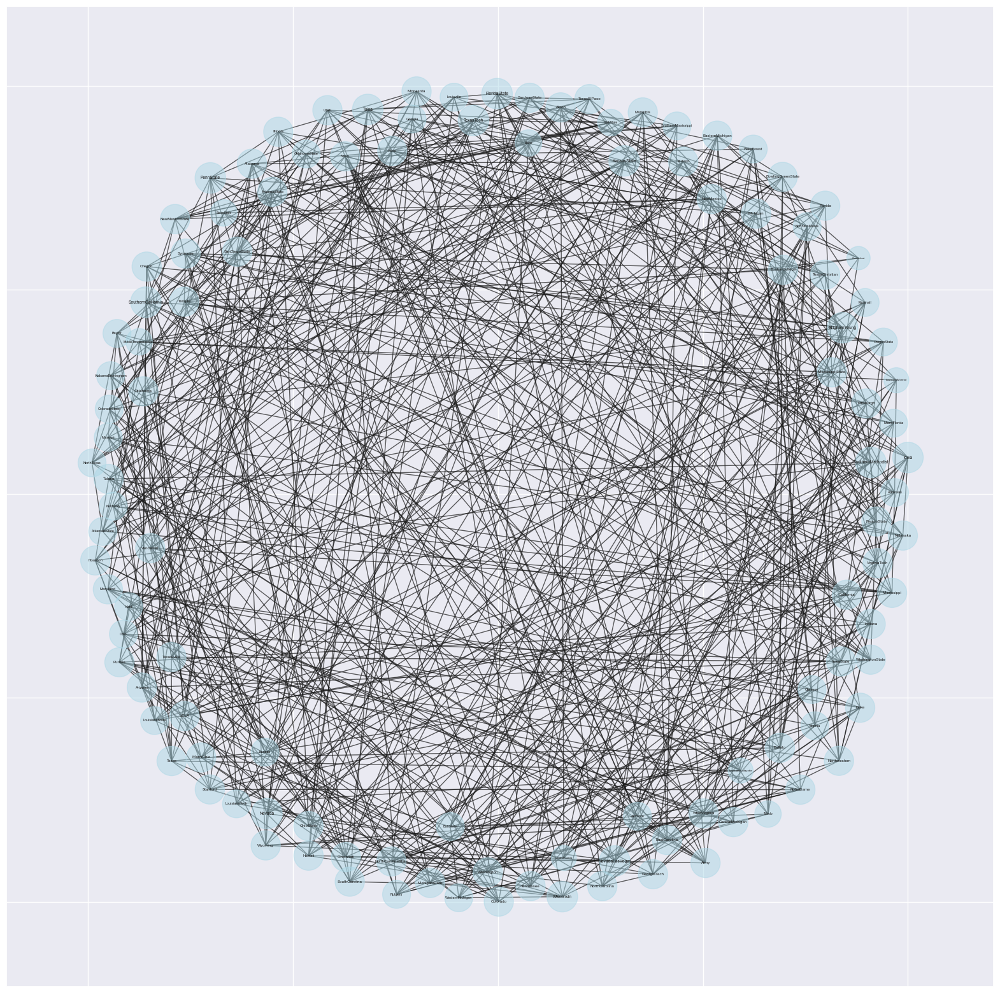

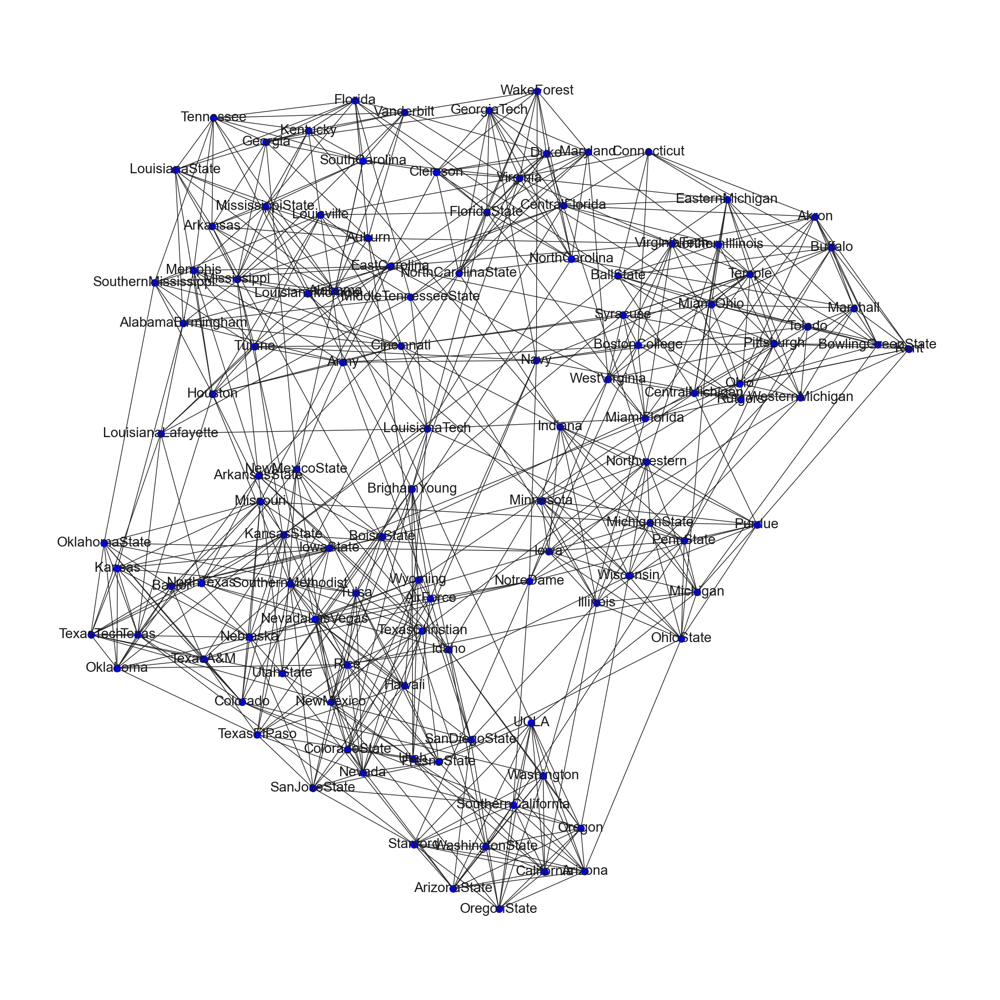

In [247]:
#football network
football=nx.read_gml(r"football.gml")

#visualize the graph
plt.figure(1,figsize=(20,20))
pos = nx.spring_layout(football,k=5)
plt.figure(4,figsize=(20,20))
nx.draw_networkx_nodes(football,pos,nodelist=dict(football.degree()).keys(),node_size=[v * 100 for v in dict(football.degree()).values()],node_color='lightblue',alpha=0.5)
nx.draw_networkx_edges(football,pos,alpha=0.7)
for n,i in { n: n for n in sorted(dict(football.degree()),key=dict(football.degree).get,reverse=True)}.items():
    nx.draw_networkx_labels(football,pos,labels={n:n},font_size=0.4*dict(football.degree()).get(n))

plt.figure(2,figsize=(20,20))
nx.draw(football, with_labels=True, node_size=100, node_color='blue', font_size=20)

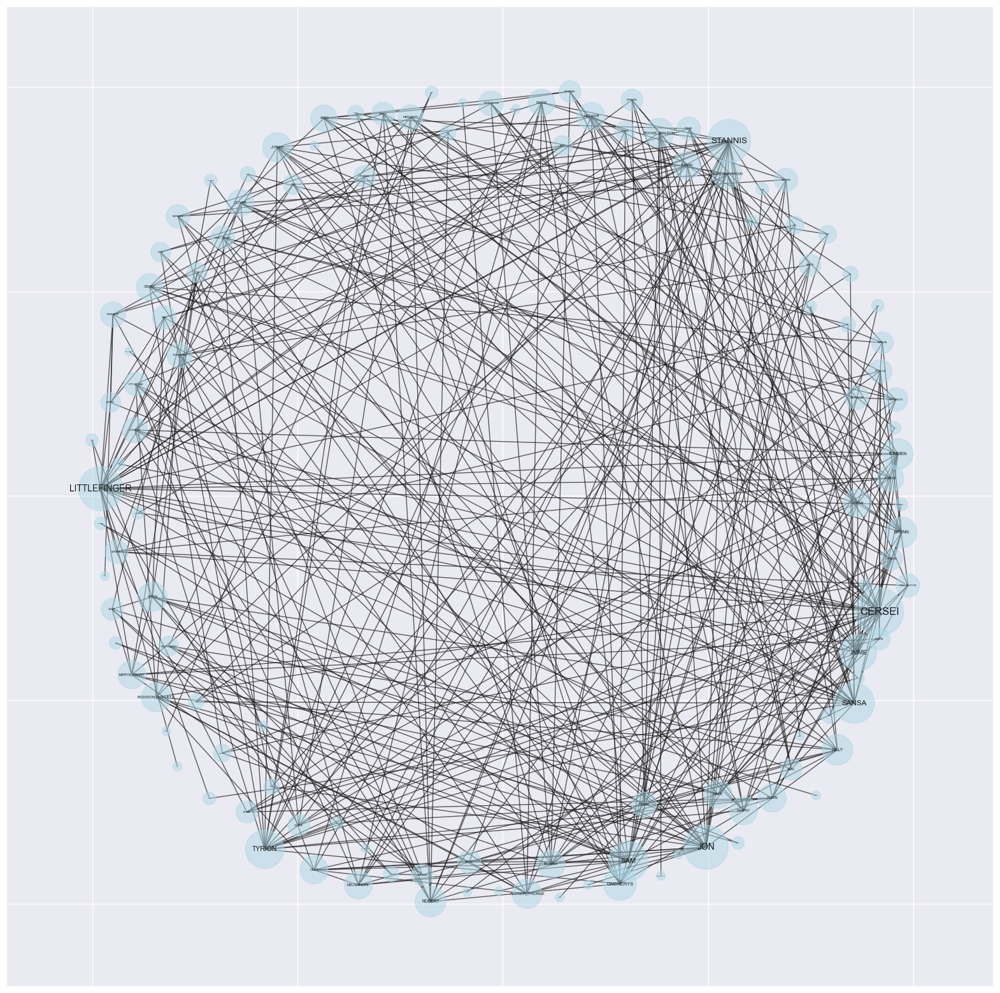

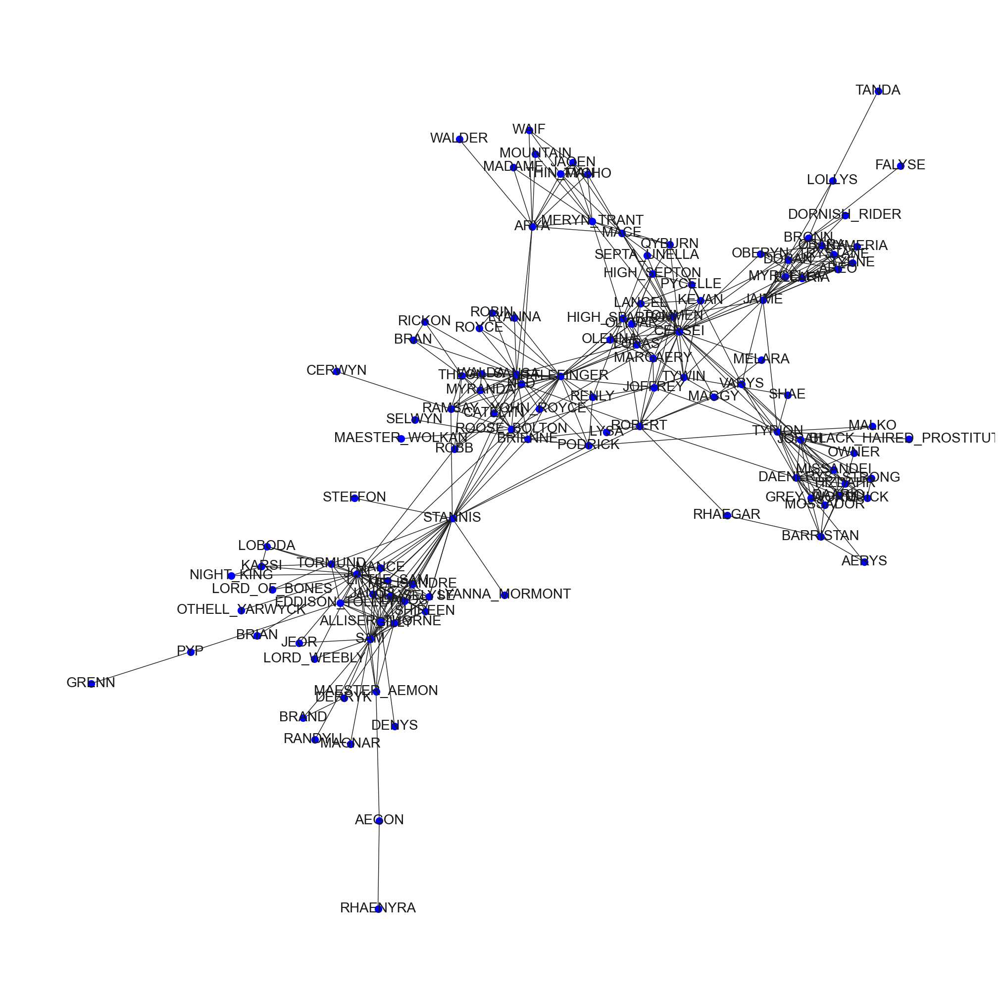

In [248]:
#Game of thrones network
import csv
got=nx.Graph()
with open('got_s5.csv') as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    line_count = 0
    next(csv_reader)
    for row in csv_reader:
        got.add_edge(row[0],row[1])
        line_count += 1


#visualize the network
pos = nx.spring_layout(got,k=5)
plt.figure(1,figsize=(20,20))
nx.draw_networkx_nodes(got,pos,nodelist=dict(got.degree()).keys(),node_size=[v * 100 for v in dict(got.degree()).values()],node_color='lightblue',alpha=0.5)
nx.draw_networkx_edges(got,pos,alpha=0.7)
for n,i in { n: n for n in sorted(dict(got.degree()),key=dict(got.degree).get,reverse=True)}.items():
    nx.draw_networkx_labels(got,pos,labels={n:n},font_size=0.4*dict(got.degree()).get(n))

plt.figure(2,figsize=(20,20))
nx.draw(got, with_labels=True, node_size=100, node_color='blue', font_size=20)

#### Προσοχή! Θα μελετήσετε τη μεγαλύτερη συνδεδεμένη συνιστώσα του δικτύου email-Eu-core, αφού πρώτα αφαιρέσετε τα self-loops. Μπορείτε να κάνετε χρήση των συναρτήσεων connected_components, subgraph, remove_edges_from του networkx.

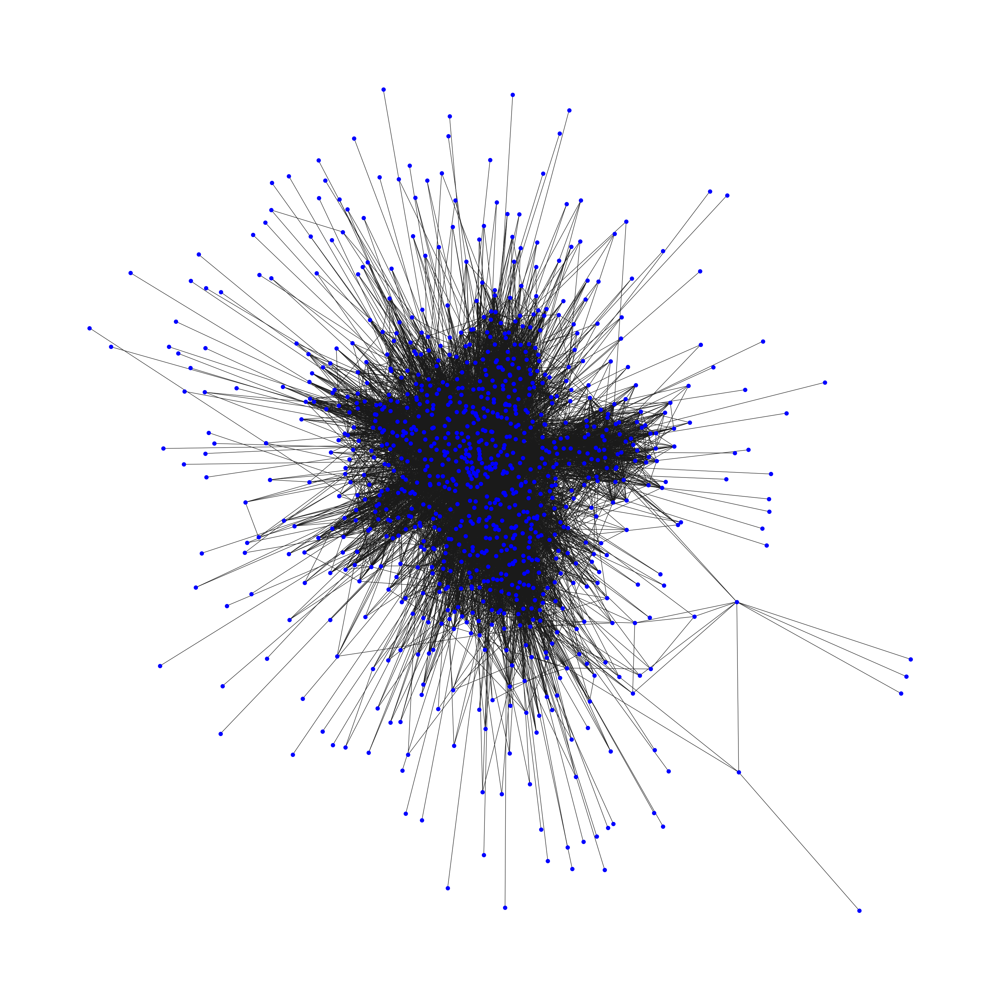

In [249]:
#email-Eu-core network
eu=nx.read_edgelist("email-Eu-core.txt",create_using=nx.Graph())
selfLoops = nx.selfloop_edges(eu)
eu.remove_edges_from(selfLoops)
cc = max(nx.connected_components(eu), key=len)
eu = eu.subgraph(cc)


#visualize the network
plt.figure(1,figsize=(30,30))
nx.draw(eu, node_size=70, node_color='blue')

<h4>Μελέτη βαθμού κόμβου για πραγματικές και συνθετικές τοπολογίες.</h4>

Text(0.5, 1.0, 'Degree Distribution of eu')

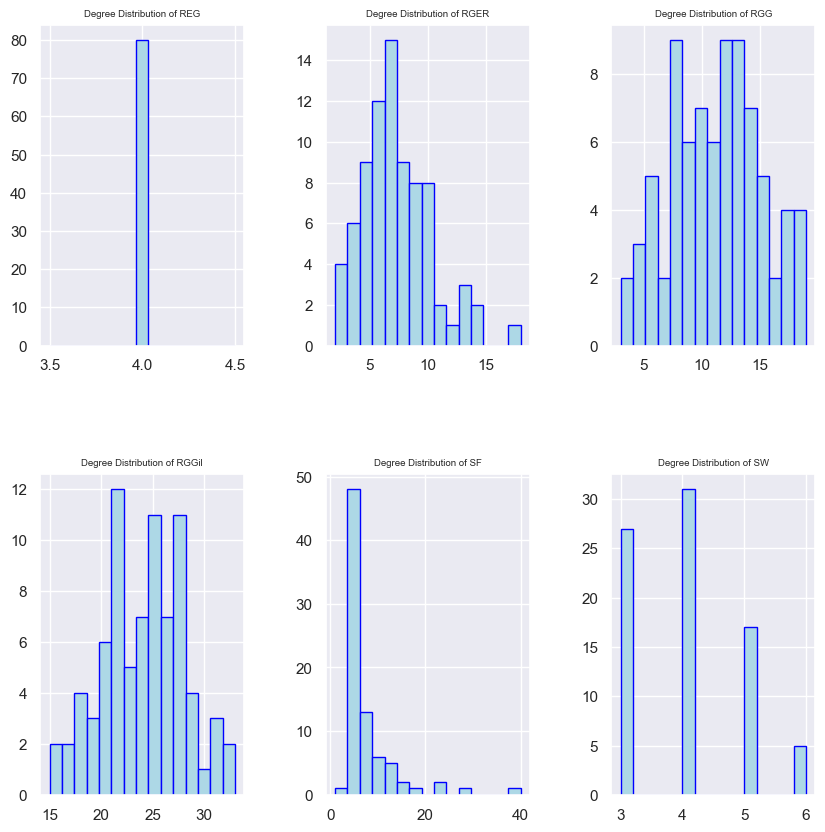

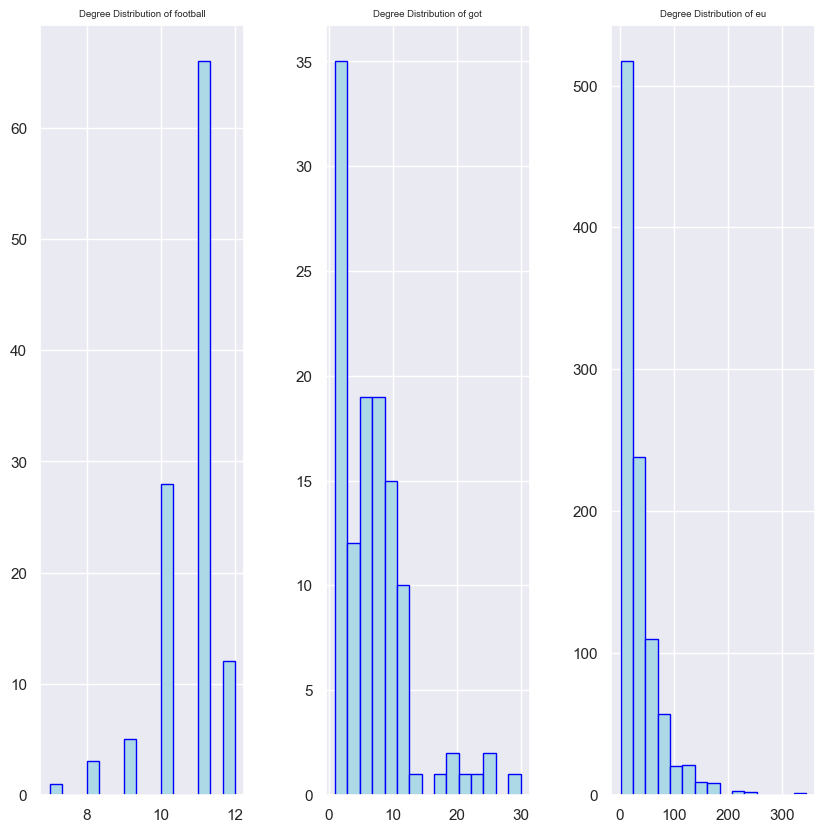

In [250]:
realGraphs = {'football' : football, 'got' : got, 'eu' : eu}

#Degree distribution for all topologies
figure1, axis = plt.subplots(2,3)
figure1.subplots_adjust(hspace=0.4,wspace=0.4)


axis[0,0].hist(list(dict(Graphs['REG'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,0].set_title("Degree Distribution of REG",fontsize='xx-small')

axis[0,1].hist(list(dict(Graphs['RGER'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,1].set_title("Degree Distribution of RGER",fontsize='xx-small')

axis[0,2].hist(list(dict(Graphs['RGG'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,2].set_title("Degree Distribution of RGG",fontsize='xx-small')

axis[1,0].hist(list(dict(Graphs['RGGil'].degree).values()), bins=15,color="lightblue", ec="blue",lw=1)
axis[1,0].set_title("Degree Distribution of RGGil",fontsize='xx-small')

axis[1,1].hist(list(dict(Graphs['SF'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[1,1].set_title("Degree Distribution of SF",fontsize='xx-small')

axis[1,2].hist(list(dict(Graphs['SW'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[1,2].set_title("Degree Distribution of SW",fontsize='xx-small')

figure2,axis = plt.subplots(1,3)
figure2.subplots_adjust(hspace=0.4,wspace=0.4)

axis[0].hist(list(dict(realGraphs['football'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[0].set_title("Degree Distribution of football",fontsize='xx-small')

axis[1].hist(list(dict(realGraphs['got'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[1].set_title("Degree Distribution of got",fontsize='xx-small')

axis[2].hist(list(dict(realGraphs['eu'].degree).values()), bins=15, color="lightblue", ec="blue",lw=1)
axis[2].set_title("Degree Distribution of eu",fontsize='xx-small')


#### Μέσος βαθμός κόμβου για πραγματικές και συνθετικές τοπολογίες

In [251]:
for name,graph in Graphs.items():
    dn = graph.degree()
    list_dn = [x[1] for x in dn]
    mean = np.mean(list_dn)
    var = np.var(list_dn)
    print(name,"\t-> mean degree :",round(mean,3), "\t-> variance :",round(var,3))
print("----------------------------------------------")
for name,graph in realGraphs.items():
    dn = graph.degree()
    list_dn = [x[1] for x in dn]
    mean = np.mean(list_dn)
    var = np.var(list_dn)
    print(name,"-> mean degree :",round(mean,3), "-> variance :",round(var,3))

REG 	-> mean degree : 4.0 	-> variance : 0.0
RGER 	-> mean degree : 7.5 	-> variance : 8.15
RGG 	-> mean degree : 11.25 	-> variance : 13.662
RGGil 	-> mean degree : 23.95 	-> variance : 15.497
SF 	-> mean degree : 7.6 	-> variance : 33.39
SW 	-> mean degree : 4.0 	-> variance : 0.8
----------------------------------------------
football -> mean degree : 10.661 -> variance : 0.781
got -> mean degree : 6.655 -> variance : 31.049
eu -> mean degree : 32.584 -> variance : 1370.888


Παρατηρούμε πως το football εχει παρόμοια κατανομή με αυτή του RGG, οπως έχει και παραπλησια μέση τιμή. Η κατανανομή του γράφου got είναι παρόμοια με αυτή της SF(πολλοί κόμβοι με μικρό βαθμό), όπως και η μέση τιμή του και η διασπορά του. Τέλος το EU Email ακολουθεί την κατανομή power law, η οποία και αυτή είναι παραπλήσια με την SF.

<h4>Μελέτη συντελεστή ομαδοποίησης για πραγματικές και συνθετικές τοπολογίες</h4>

Text(0.5, 1.0, 'Clustering Coefficient Distribution of eu')

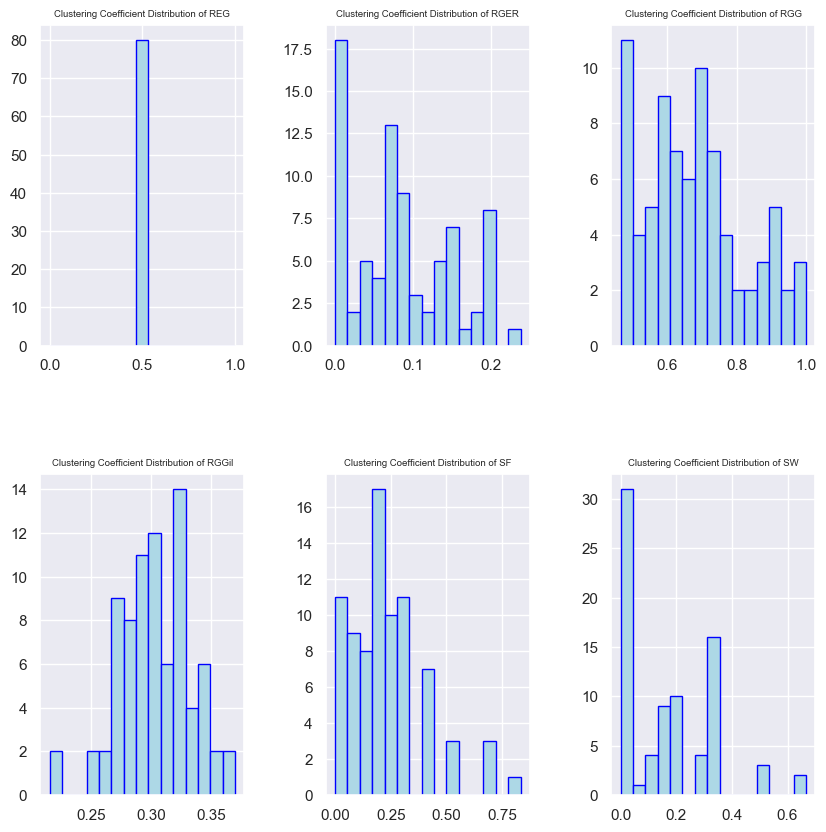

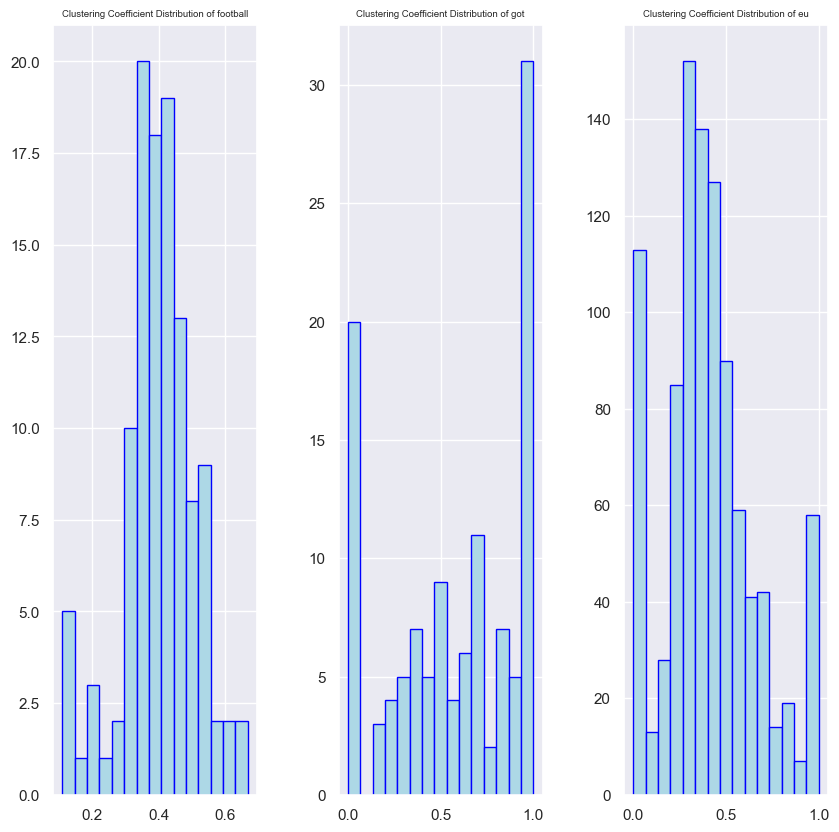

In [252]:
#returns a dictionary {node : clustering coefficient}
def cc(G):
    g = {key: round(val,4) for key, val in nx.clustering(G).items() }
    return g

figure1, axis = plt.subplots(2,3)
figure1.subplots_adjust(hspace=0.4,wspace=0.4)


axis[0,0].hist(cc(Graphs['REG']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,0].set_title("Clustering Coefficient Distribution of REG",fontsize='xx-small')

axis[0,1].hist(cc(Graphs['RGER']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,1].set_title("Clustering Coefficient Distribution of RGER",fontsize='xx-small')

axis[0,2].hist(cc(Graphs['RGG']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,2].set_title("Clustering Coefficient Distribution of RGG",fontsize='xx-small')

axis[1,0].hist(cc(Graphs['RGGil']).values(), bins=15,color="lightblue", ec="blue",lw=1)
axis[1,0].set_title("Clustering Coefficient Distribution of RGGil",fontsize='xx-small')

axis[1,1].hist(cc(Graphs['SF']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[1,1].set_title("Clustering Coefficient Distribution of SF",fontsize='xx-small')

axis[1,2].hist(cc(Graphs['SW']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[1,2].set_title("Clustering Coefficient Distribution of SW",fontsize='xx-small')

figure2,axis = plt.subplots(1,3)
figure2.subplots_adjust(hspace=0.4,wspace=0.4)

axis[0].hist(cc(realGraphs['football']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0].set_title("Clustering Coefficient Distribution of football",fontsize='xx-small')

axis[1].hist(cc(realGraphs['got']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[1].set_title("Clustering Coefficient Distribution of got",fontsize='xx-small')

axis[2].hist(cc(realGraphs['eu']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[2].set_title("Clustering Coefficient Distribution of eu",fontsize='xx-small')


#### Μέσος συντελεστής ομαδοποίησης για πραγματικές και συνθετικές τοπολογίες

In [253]:
for name,graph in Graphs.items():
    mean = nx.average_clustering(graph)
    var = np.array(list(cc(graph).values()))
    var = np.var(var)
    print(name,"\t-> mean degree :",round(mean,3), "\t-> variance :",round(var,3))
print("----------------------------------------------")
for name,graph in realGraphs.items():
    mean = nx.average_clustering(graph)
    var = np.array(list(cc(graph).values()))
    var = np.var(var)
    print(name,"-> mean degree :",round(mean,3), "-> variance :",round(var,3))

REG 	-> mean degree : 0.5 	-> variance : 0.0
RGER 	-> mean degree : 0.085 	-> variance : 0.004
RGG 	-> mean degree : 0.683 	-> variance : 0.021
RGGil 	-> mean degree : 0.303 	-> variance : 0.001
SF 	-> mean degree : 0.229 	-> variance : 0.029
SW 	-> mean degree : 0.167 	-> variance : 0.028
----------------------------------------------
football -> mean degree : 0.403 -> variance : 0.011
got -> mean degree : 0.574 -> variance : 0.126
eu -> mean degree : 0.407 -> variance : 0.061


Βλέπουμε ότι η κατανομή του Football είναι παραπλήσια με αυτήν της RGGil και της RGG οπότε συμπεραίνουμε ότι football είναι τυχαίος γράφος. Ακόμα στον γράφο Game of Thrones παρατηρούμε οτι έχει κατανομή που δεν πλησιάζει σε κάποια άλλη. Παρ' όλα αυτά μοιάζει πιο πολύ με την κατανομή SF. Τέλος το EU EMAIL έχει κατανομή σαν να είναι τυχαίος γράφος δηλάδη είτε RGG είτε RGGil.

<h4>Μελέτη κεντρικότητας εγγύτητας για πραγματικές και συνθετικές τοπολογίες </h4>

Text(0.5, 1.0, 'Closeness Centrality Distr of eu')

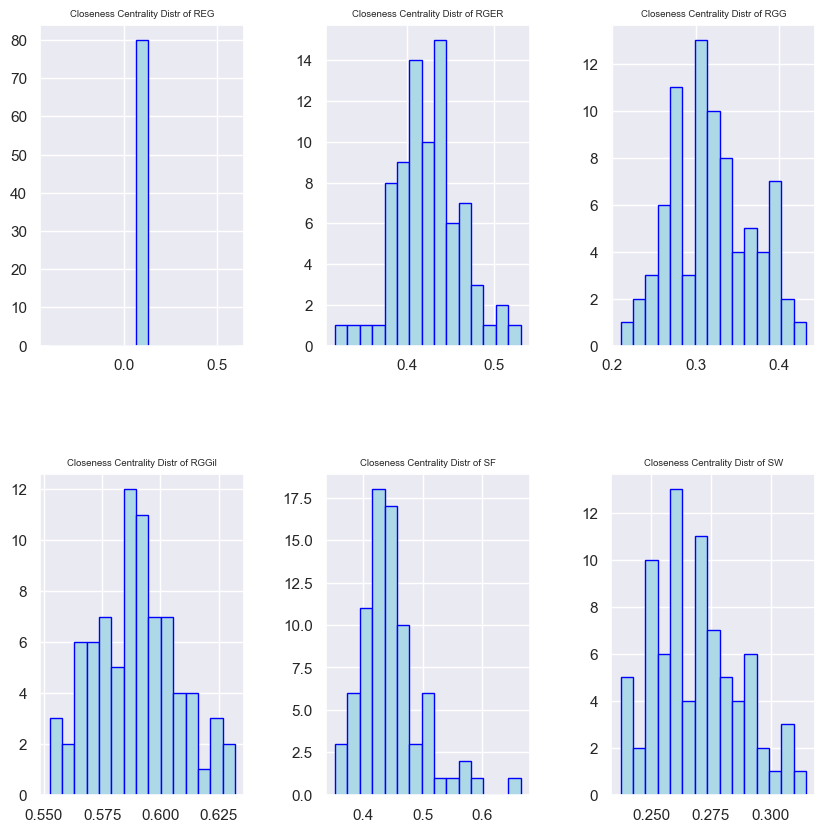

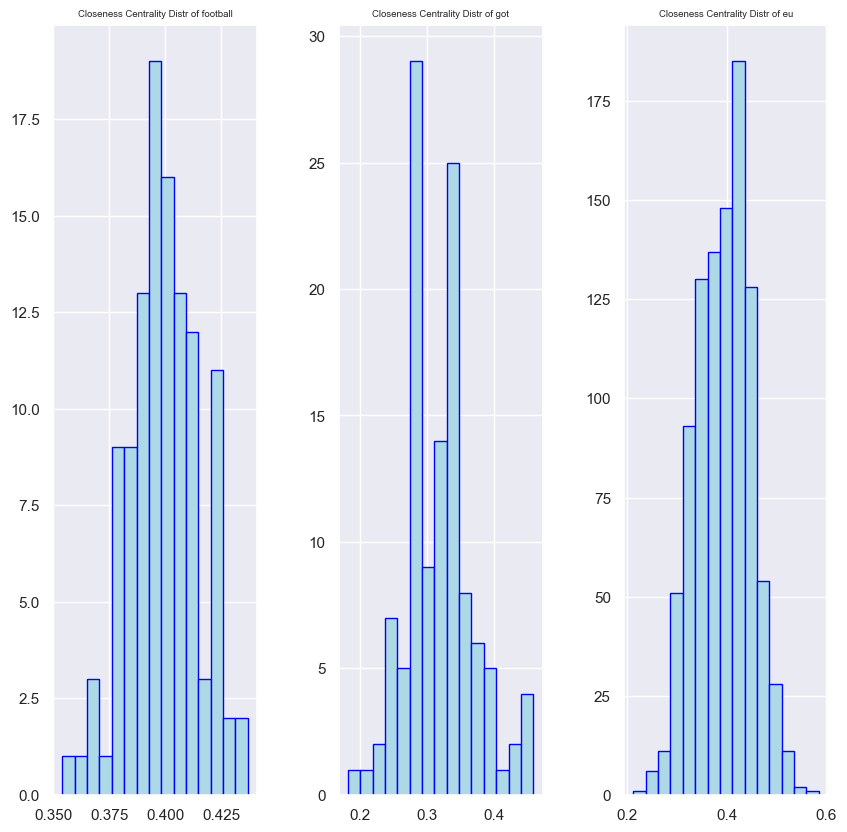

In [254]:


figure1, axis = plt.subplots(2,3)
figure1.subplots_adjust(hspace=0.4,wspace=0.4)


axis[0,0].hist(nx.closeness_centrality(Graphs['REG']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,0].set_title("Closeness Centrality Distr of REG",fontsize='xx-small')

axis[0,1].hist(nx.closeness_centrality(Graphs['RGER']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,1].set_title("Closeness Centrality Distr of RGER",fontsize='xx-small')

axis[0,2].hist(nx.closeness_centrality(Graphs['RGG']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0,2].set_title("Closeness Centrality Distr of RGG",fontsize='xx-small')

axis[1,0].hist(nx.closeness_centrality(Graphs['RGGil']).values(), bins=15,color="lightblue", ec="blue",lw=1)
axis[1,0].set_title("Closeness Centrality Distr of RGGil",fontsize='xx-small')

axis[1,1].hist(nx.closeness_centrality(Graphs['SF']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[1,1].set_title("Closeness Centrality Distr of SF",fontsize='xx-small')

axis[1,2].hist(nx.closeness_centrality(Graphs['SW']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[1,2].set_title("Closeness Centrality Distr of SW",fontsize='xx-small')

figure2,axis = plt.subplots(1,3)
figure2.subplots_adjust(hspace=0.4,wspace=0.4)

axis[0].hist(nx.closeness_centrality(realGraphs['football']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[0].set_title("Closeness Centrality Distr of football",fontsize='xx-small')

axis[1].hist(nx.closeness_centrality(realGraphs['got']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[1].set_title("Closeness Centrality Distr of got",fontsize='xx-small')

axis[2].hist(nx.closeness_centrality(realGraphs['eu']).values(), bins=15, color="lightblue", ec="blue",lw=1)
axis[2].set_title("Closeness Centrality Distr of eu",fontsize='xx-small')


In [255]:

for name,graph in Graphs.items():
    dn = nx.closeness_centrality(graph)
    mean = sum(dn.values())/len(dn)
    var = np.var(list(dn.values()))
    print(name,"\t-> mean closeness :",round(mean,3), "\t-> variance :",round(var,3))
print("----------------------------------------------")
for name,graph in realGraphs.items():
    dn = nx.closeness_centrality(graph)
    mean = sum(dn.values())/len(dn)
    var = np.var(list(dn.values()))
    print(name,"\t-> mean closeness :",round(mean,3), "\t-> variance :",round(var,3))

REG 	-> mean closeness : 0.096 	-> variance : 0.0
RGER 	-> mean closeness : 0.424 	-> variance : 0.001
RGG 	-> mean closeness : 0.32 	-> variance : 0.002
RGGil 	-> mean closeness : 0.59 	-> variance : 0.0
SF 	-> mean closeness : 0.446 	-> variance : 0.003
SW 	-> mean closeness : 0.269 	-> variance : 0.0
----------------------------------------------
football 	-> mean closeness : 0.399 	-> variance : 0.0
got 	-> mean closeness : 0.319 	-> variance : 0.003
eu 	-> mean closeness : 0.394 	-> variance : 0.003


Παρατηρούμε οτι η κατανομή του football μοιάζει πολύ με αυτήν της RGER και RGGil. Για το got παρατηρούμε οτι έχει παραπλήσια κατανομή με αυτή του SF και τέλος το EU MAIL με αυτή του RGER και του RGGil.


#### Συμπεράσματα
Από την σύγκριση των μετρικών καθως και από τις οπτικοποποιήσεις συμπεραίνουμε ότι ο γράφος football έχει κυρίως χαρακτηριστικά τυχαίου γράφου RGGil. O got γράφος είναι SF καθώς εμφανίζει κατανομές power low και από την οπτικοποιήση βλέπουμε ότι λίγοι κόμβοι έχουν μεγάλο βαθμό ενώ η πλειοψηφία τους μικρό. Τέλος το EU Mail είναι πιθανότερα RGER ή RGGil γράφος.  

<h3>B. Εξοικείωση με τα εργαλεία εντοπισμού κοινοτήτων</h3>
<ol>
<li>Χρησιμοποιώντας τις συναρτήσεις του <b>πίνακα 2</b> για κάθε <u>πραγματικό</u> (<b>πίνακας 1</b>) και <u>συνθετικό</u> (από την <b>άσκηση 1</b>) δίκτυο:</p>
<ol>
    <li>να οπτικοποιηθούν οι κοινότητες που προκύπτουν από την κάθε μέθοδο,</li>
    <li>να γίνουν οι απαραίτητοι σχολιασμοί (π.χ: σύγκριση του αριθμού των κοινοτήτων που υπολογίζει ο κάθε αλγόριθμος).</li>
</ol>
<p>Για την οπτικοποίηση, να επισημανθεί διαφορετικά κάθε κοινότητα, π.χ. με διαφορετικό χρώμα.</p>
<p style=text-align:justify>Στην περίπτωση των συνθετικών δικτύων, να πραγματοποιηθούν συγκρίσεις και μεταξύ των διαφορετικών τύπων τοπολογιών. Για παράδειγμα, στην περίπτωση του τυχαίου γεωμετρικού γράφου, υπάρχει διαισθητικά μία κοινότητα γύρω από κάθε κόμβο που δημιουργείται με βάση τις αποστάσεις του τελευταίου από τους υπόλοιπους κόμβους του δικτύου. Στην περίπτωση των scale-free δικτύων, είναι πιθανό να σχηματίζονται κοινότητες γύρω από τους κόμβους με μεγάλο βαθμό.</p>
<li>Για κάθε αλγόριθμο εντοπισμού κοινοτήτων και για κάθε τοπολογία αξιολογήστε την ποιότητα της διαμέρισης με τις μετρικές performance και modularity (<a style=text-decoration:none href='https://networkx.org/documentation/stable/reference/algorithms/community.html#module-networkx.algorithms.community.quality'>measuring_partitions</a>). Για την μετρική performance, θα χρησιμοποιήσετε την συνάρτηση partition_quality του networkx.</li>
<li>Για την μεγαλύτερη συνδεδεμένη συνιστώσα του email-Eu-core, να συγκρίνετε την ground-truth διαμέριση που δίνεται στο αρχείο Email-Eu-core-department-labels.txt με τις διαμερίσεις που προκύπτουν από τις εξεταζόμενες μεθόδους ως προς το πλήθος των παραγόμενων κοινοτήτων και ως προς τις μετρικές performance και modularity. </li>
<li>Για την παρακολούθηση του χρόνου εκτέλεσης της υλοποίησής σας, μπορείτε να χρησιμοποιήσετε τις βιβλιοθήκες <a style=text-decoration:none href='https://tqdm.github.io/'>tqdm</a> και <a style=text-decoration:none href='https://docs.python.org/3/library/time.html'>time</a> . Στο σχολιασμό σας να λάβετε υπόψη το trade-off της ποιότητας της διαμέρισης και του χρόνου εκτέλεσης των εξεταζόμενων αλγορίθμων. </li>
</ol>

<table style=float:left;width:70%>
    <caption>Πίνακας <b>2</b>: Συναρτήσεις εντοπισμού κοινοτήτων</caption>
    <tr>
        <th style=text-align:left> Μέθοδος εντοπισμού κοινοτήτων</th>
        <th style=text-align:left>Συνάρτηση</th>
    </tr>
    <tr>
        <td style=text-align:left>Spectral Clustering</td>
        <td style=text-align:left><a style=text-decoration:none href='http://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html'>SpectralClustering</a></td>
    </tr>
       <tr>
        <td style=text-align:left>Newman-Girvan</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html'>girvan_newman</a></td>
    </tr>
    <tr>
        <td style=text-align:left>Modularity Maximization</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html'>greedy_modularity_communities</a></td>
    </tr>
</table>
    

<p style=text-align:justify>Προτού εφαρμόσετε τις συναρτήσεις εντοπισμού κοινοτήτων μελετήστε προσεκτικά την <b>είσοδο που απαιτούν καθώς και τη μορφή εξόδου που παράγουν.</b></p>

In [256]:
#Χρησιμοποιήστε την συνάρτηση conv2int για να μετατρέψετε τα labels των κόμβων στις πραγματικές τοπολογίες σε integers
import time

def conv2int(G,start_value):
    nG = nx.convert_node_labels_to_integers(G,first_label=start_value)
    G_mapping=dict(enumerate(G.nodes,0))
    return nG,G_mapping

In [257]:
mapping = {}
for name,graph in realGraphs.items():
    realGraphs[name],mapping[name] = conv2int(graph,0)

<h4> Ορισμός χρωμάτων για την οπτικοποίηση των κοινοτήτων.</h4>

In [258]:
#insert colors for nodes
from matplotlib import colors as mcolors
colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())

#### Ορισμος συνάρτησης για την παραγωγή και αξιολόγηση των partitions

In [259]:
from timeit import default_timer as timer
from datetime import timedelta


def highestPartions(method, name,graph,best=-1):
    s = timer()
    partitions = method(graph,name)#[ p for p in method(graph,name)]
    print("\tFor graph ",name," generated ",len(partitions)," partitions and needed ",timedelta(seconds=timer()-s)," seconds to elapse\n")
    BestModularity = sorted(partitions, key=lambda x: nx.community.modularity(graph,x) , reverse=True)[:best]
    BestQuality = sorted(partitions, key=lambda x: nx.community.partition_quality(graph,x)[1] , reverse=True)[:best]
    return BestModularity,BestQuality


#### Ορισμός συναρτήσης για την οπτικοποίηση των κοινοτήτων

In [260]:
from sklearn import preprocessing
# draws all the partions of a graph
def drawPartitions(graph,partitions,title,axis,plot=6):
    scaledDegrees = list(
        preprocessing.minmax_scale(
            list(
                dict(graph.degree).values()
                ),
             (10, 200)))
    nodePosition = nx.spring_layout(graph)
    for i, s in enumerate(partitions[0]):
        CScaledDegree = [scaledDegrees[i] for i in list(s)]
        nx.draw_networkx_nodes(graph,
                               nodePosition,
                               nodelist=list(s),
                               node_size= CScaledDegree,
                               node_color=colors[i],
                               ax=axis)
    nx.draw_networkx_edges(graph, nodePosition, alpha=0.3, ax=axis)
    axis.set_title(title)

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Newman-Girvan.</h4>
<p>Παράξτε τις διαμερίσεις που προκύπτουν από την μέθοδο Newman-Girvan. Ελέγξτε τις διαμερίσεις που έχουν μέχρι και 50 κοινότητες.</p> 
<p> Επιλέξτε τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

O Newman-Girvan αποτελεί μία μέθοδο hierarchical-centric. Για να ανιχνεύσει τις κοινότητες,λειτουργεί επαναληπτικά εώς ότου κάθε κόμβος να είναι μία κοινότητα. Πρώτα αφαιρεί τις ακμές του αρχικού γράφου με το μεγαλύτερο betweeness centrality και τα συνδεδεμένα τμήματα του παραγόμενου γράφου αποτελούν τις κοινότητες.

In [261]:
from tqdm import tqdm

def NewmanGirvan(graph,name):
    print("NewmanGirvan method :\n\tCreating partitions for graph",name,"...")
    partitions = []
    for p in tqdm(nx.community.girvan_newman(graph)):
        if len(p) > 50:
            break
        partitions.append(p)
    return partitions
#returns a list of tuple of dict [({...},{...}),({...},{...})]


<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Spectral Clustering. </h4>
Προσοχή! Για την επιλογή της τιμής της παραμέτρου που αφορά στην διάσταση του projection subspace (n_clusters) της συνάρτησης SpectralClustering, θα πρέπει να λάβετε υπόψη το μέγεθος |V| του εκάστοτε δικτύου.
<p>Να εξετάσετε τις διαμερίσεις που προκύπτουν για n_clusters$=2,...,|V|$. Να επιλέξετε για οπτικοποίηση τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

Ο αλγόριθμος Spectral Clustering αποτελεί μία μέθοδο unsupervised learning. Πρέπει πρώτα να υπολογίσουμε τον πίνακα γειτνίασης του γράφου και στη συνέχεια για clusters από 2 μέχρι 50 η συνάρτηση επιστρέφει τα communities,τα οποία μετατρέπουμε σε μορφή κατάλληλη για επεξεργασία.

In [262]:
from sklearn.cluster import SpectralClustering
from tqdm import tqdm

def Spectral(graph,name):
    print("Spectral method :\n\tCreating partitions for graph",name,"...")
    partitions = []
    arr = nx.to_numpy_array(graph)
    for i in tqdm(range(2,50)):
        clustering = SpectralClustering(n_clusters=i, assign_labels='discretize', random_state=0).fit(arr)
        partitions.append(list(enumerate(clustering.labels_)))
    result = []
    for p in partitions:
      communities = {}
      for i in p:
        v,c = i
        if communities.get(c):
          communities[c].append(v)
        else:
          communities[c] = [v]
      result.append(tuple(communities.values()))
    return result


<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Modularity Maximization.</h4>
Για την διαμέριση που θα προκύψει σε κάθε συνθετικό και πραγματικό δίκτυο, να υπολογίσετε το modularity score και το performance score.

Η συγκεκριμένη συνάρτηση χρησιμοποιεί τον αλγόριθμο Clauset-Newman-Moore Modularity Maximization όποιος θεωρεί ένα κόμβο ως μια κοινότητα και ενώνει τα ζεύγη των κοινότήτων με σκοπό να αυξήσει το modularity

In [263]:

def ModMaximization(graph,name):
    print("ModMaximization method :\n\tCreating partitions for graph",name,"...")
    return [list(p) for p in tqdm(nx.algorithms.community.greedy_modularity_communities(graph))]


#### Οπτικοποίηση κοινοτήτων American College Football

NewmanGirvan method :
	Creating partitions for graph football ...


49it [00:03, 13.13it/s]


	For graph  football  generated  49  partitions and needed  0:00:03.737200  seconds to elapse

Spectral method :
	Creating partitions for graph football ...


100%|██████████| 48/48 [00:16<00:00,  2.86it/s]


	For graph  football  generated  48  partitions and needed  0:00:16.797973  seconds to elapse

ModMaximization method :
	Creating partitions for graph football ...


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.5996290274077957
Lenght: 18
Performance: 0.9369946605644546
=================== Spectral Method ======================
Modularity: 0.60320436225447
Lenght: 14
Performance: 0.9421815408085431
=================== ModMaximization Method ======================
Modularity: 0.5497406651426807
Lenght: 27
Performance: 0.7308319738988581


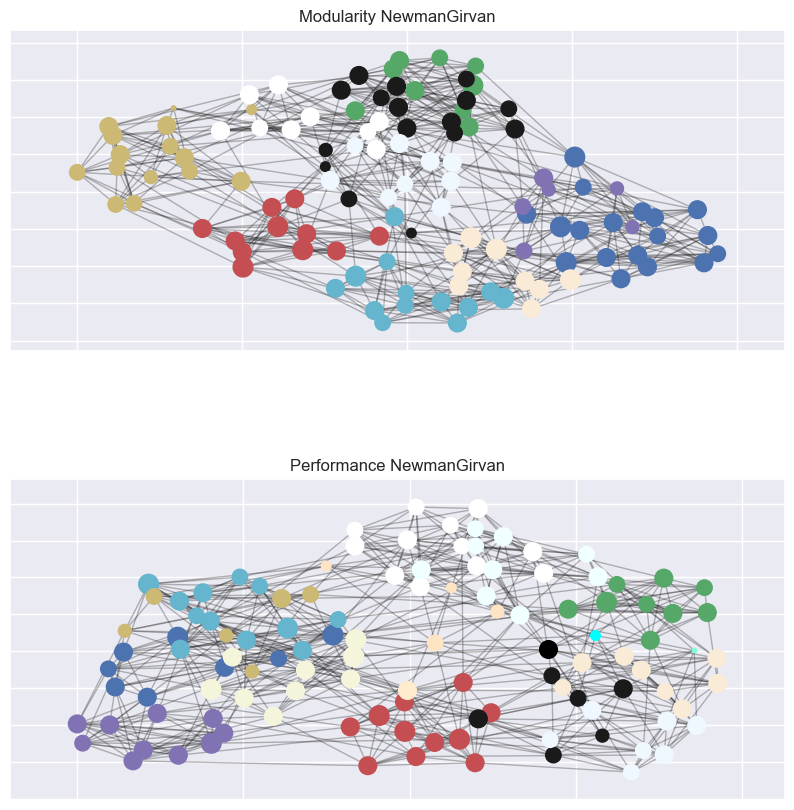

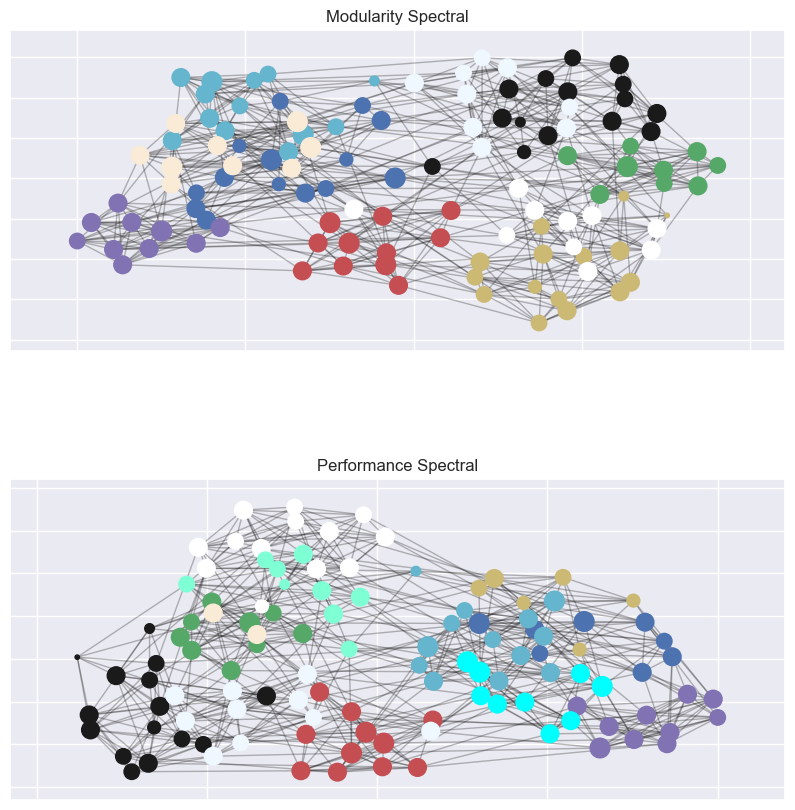

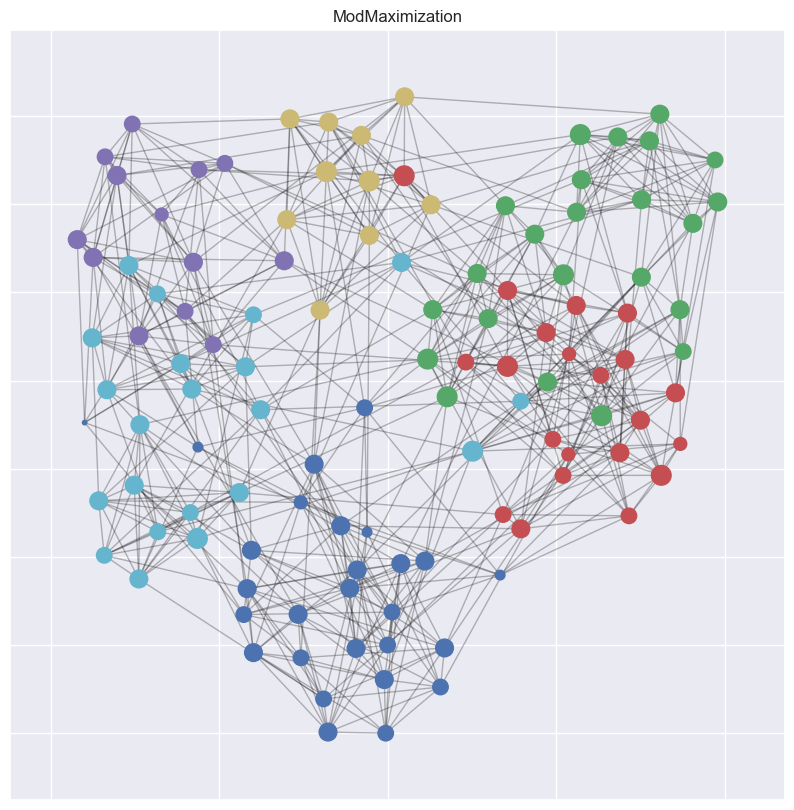

In [264]:
import seaborn as sns
sns.set_palette('cubehelix')
sns.set()

methods = {'NewmanGirvan':NewmanGirvan,'Spectral':Spectral,'ModMaximization':ModMaximization}


ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(realGraphs['football'],'football')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'football',realGraphs['football'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(realGraphs['football'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(realGraphs['football'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(realGraphs['football'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1


for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(realGraphs['football'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(realGraphs['football'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(realGraphs['football'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(realGraphs['football'],ModPartitions[name][0])[1])


#### Οπτικοποίηση κοινοτήτων Game of Thrones

NewmanGirvan method :
	Creating partitions for graph got ...


49it [00:01, 39.74it/s]


	For graph  got  generated  49  partitions and needed  0:00:01.234505  seconds to elapse

Spectral method :
	Creating partitions for graph got ...


100%|██████████| 48/48 [00:16<00:00,  2.86it/s]


	For graph  got  generated  48  partitions and needed  0:00:16.768321  seconds to elapse

ModMaximization method :
	Creating partitions for graph got ...


100%|██████████| 5/5 [00:00<00:00, 7681.88it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.6681205999387817
Lenght: 10
Performance: 0.8722404215923658
=================== Spectral Method ======================
Modularity: 0.4375860881542699
Lenght: 77
Performance: 0.5775530551203533
=================== ModMaximization Method ======================
Modularity: 0.660477884909703
Lenght: 35
Performance: 0.8787878787878788


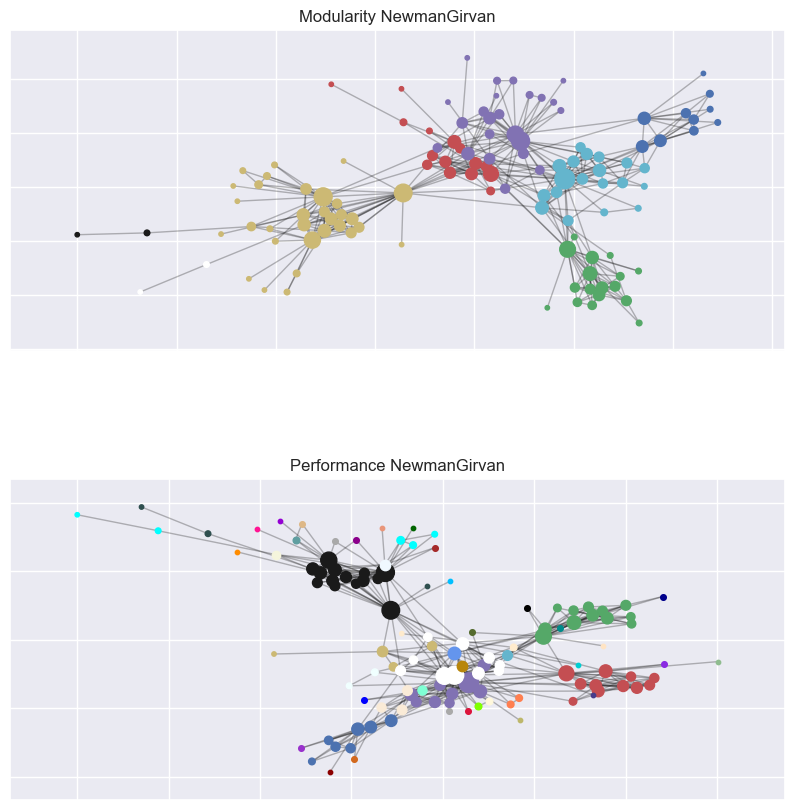

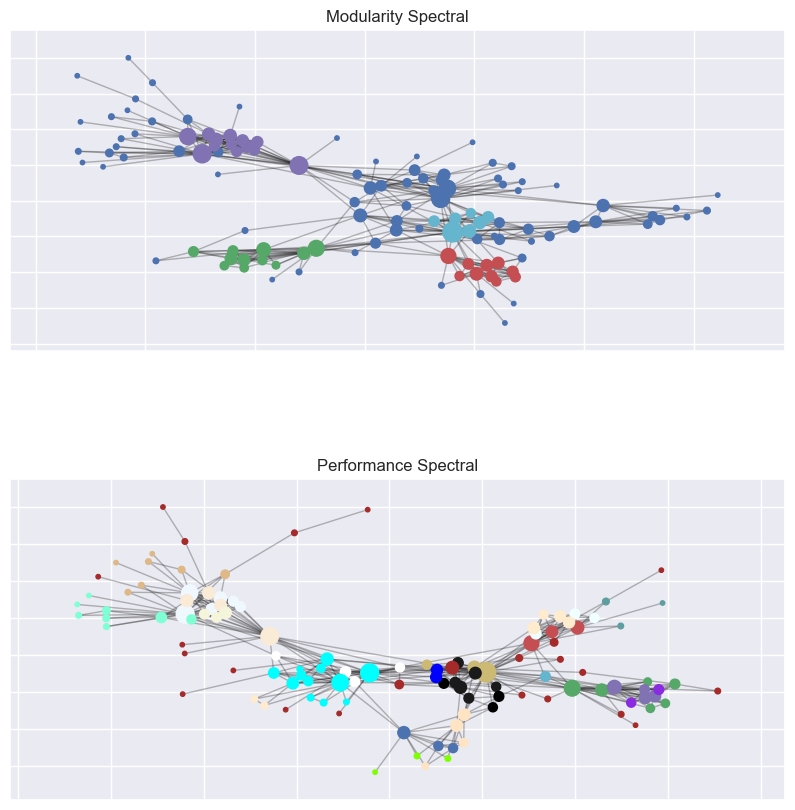

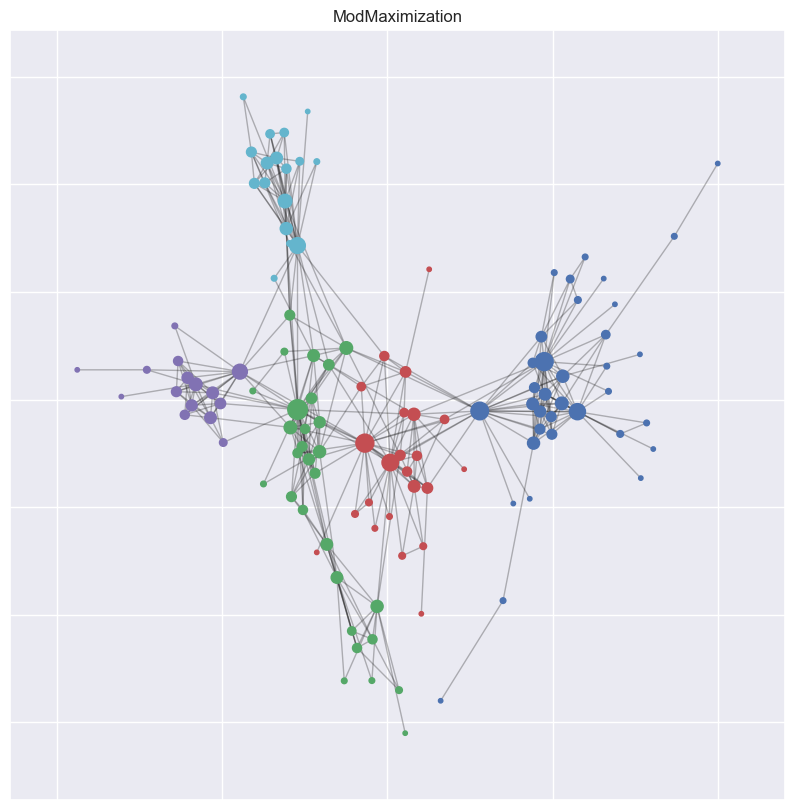

In [265]:
ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(realGraphs['got'],'got')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'got',realGraphs['got'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(realGraphs['got'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(realGraphs['got'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(realGraphs['got'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1


for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(realGraphs['got'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(realGraphs['got'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(realGraphs['got'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(realGraphs['got'],ModPartitions[name][0])[1])


#### Οπτικοποίηση κοινοτήτων email-Eu-core (να οπτικοποιηθεί και η ground-truth διαμέριση)

NewmanGirvan method :
	Creating partitions for graph eu ...


49it [04:40,  5.72s/it]


	For graph  eu  generated  49  partitions and needed  0:04:40.295162  seconds to elapse

Spectral method :
	Creating partitions for graph eu ...


100%|██████████| 48/48 [02:19<00:00,  2.90s/it]


	For graph  eu  generated  48  partitions and needed  0:02:19.234455  seconds to elapse

ModMaximization method :
	Creating partitions for graph eu ...


100%|██████████| 8/8 [00:00<00:00, 216480.21it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.0006218821799455388
Lenght: 980
Performance: 0.04515604246249524
=================== Spectral Method ======================
Modularity: 0.1692824595387127
Lenght: 640
Performance: 0.5593290843380937
=================== ModMaximization Method ======================
Modularity: 0.3471325650460906
Lenght: 391
Performance: 0.6848232071713147


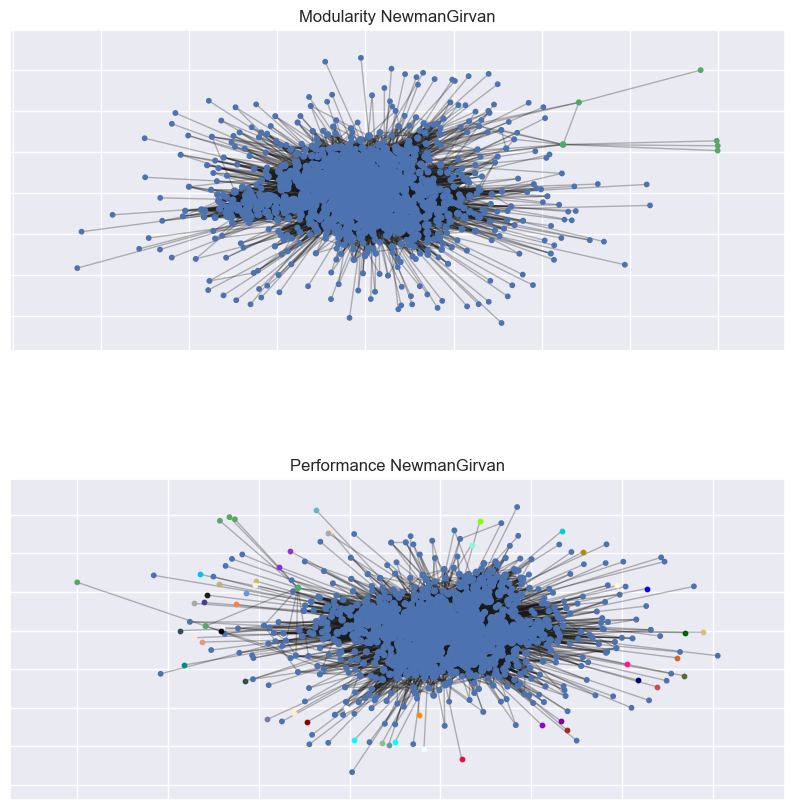

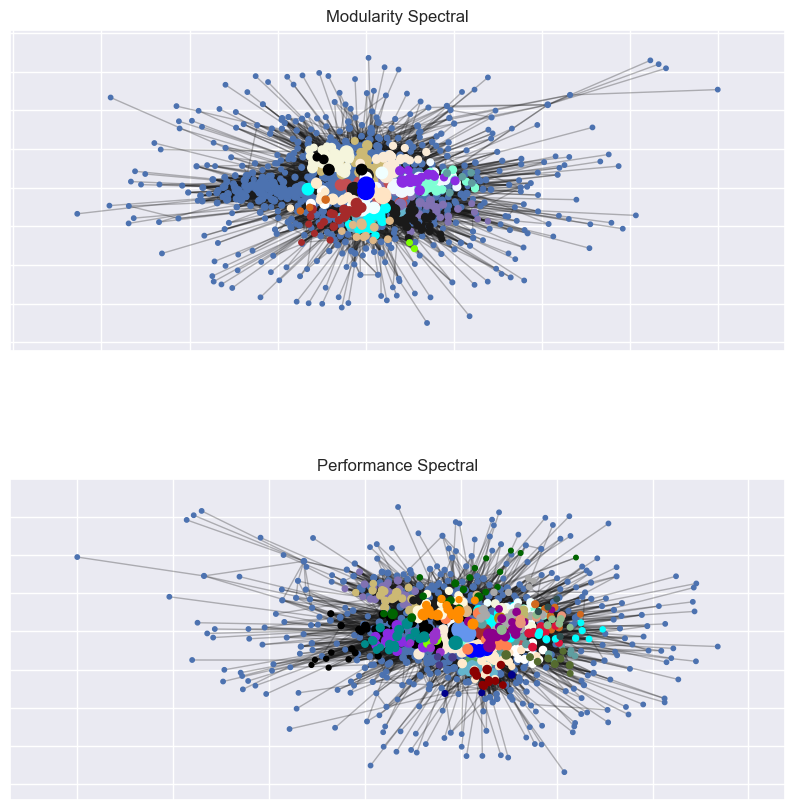

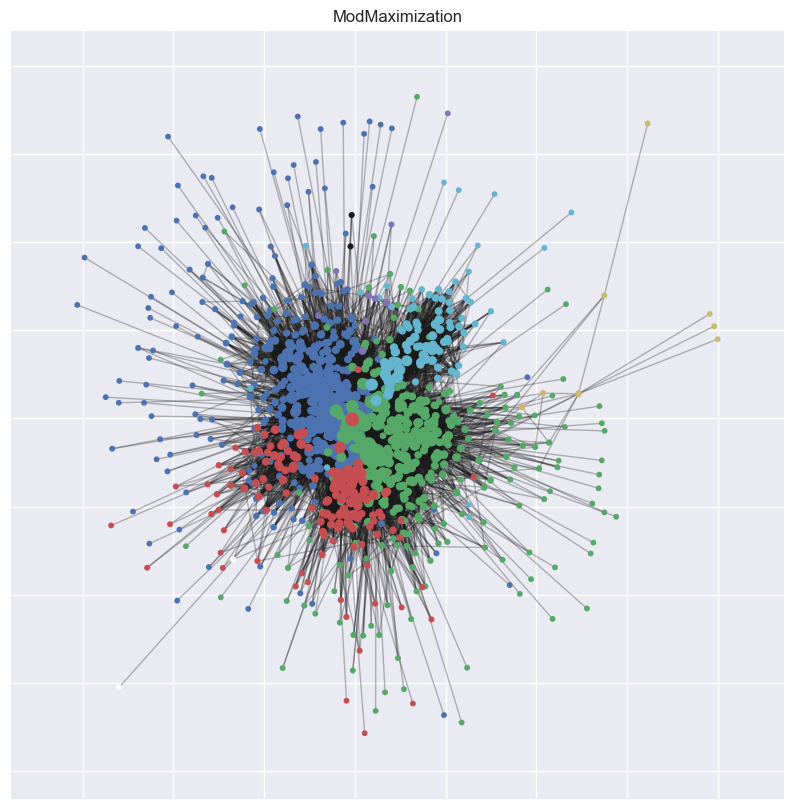

In [266]:
ModPartitions = {}
QualPartitions = {}

ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(realGraphs['eu'],'eu')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'eu',realGraphs['eu'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(realGraphs['eu'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(realGraphs['eu'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(realGraphs['eu'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1


for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(realGraphs['eu'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(realGraphs['eu'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(realGraphs['eu'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(realGraphs['eu'],ModPartitions[name][0])[1])


Ground truth for email-Eu-core has 42 communities 
Its modularity is 0.288 and its performance is 0.9428


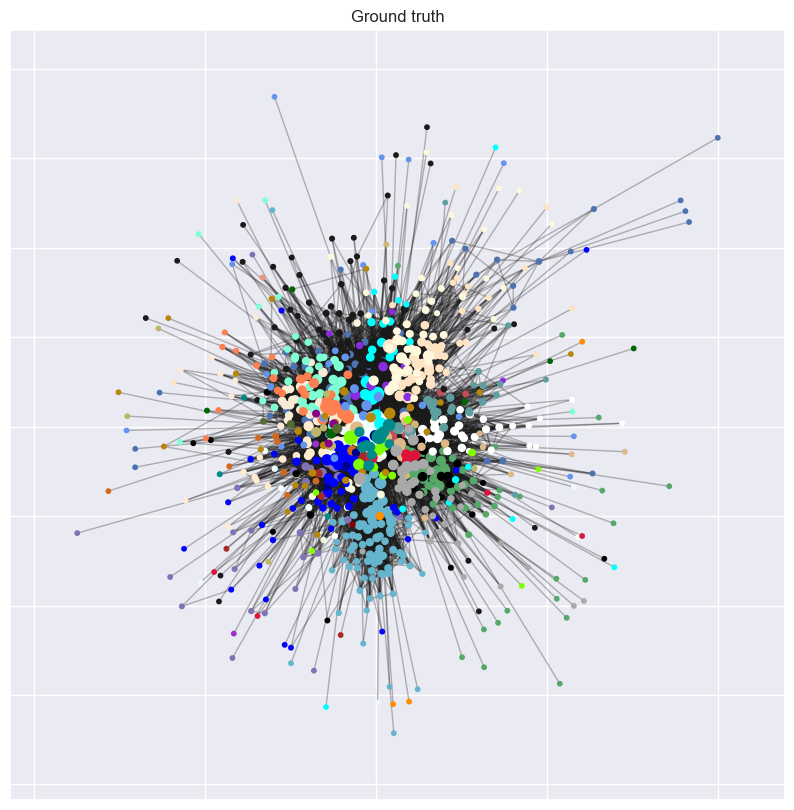

In [267]:
node_mapping = dict((v, k) for k, v in mapping['eu'].items())
eu_communities_ground_truth = {}
with open("./email-Eu-core-department-labels.txt", "r") as f:
    for line in f:
        numbers = [x for x in line.split()]
        node = numbers[0]
        community_number = int(numbers[1])
        if (node in node_mapping):
            node = node_mapping[node]
            try:
                eu_communities_ground_truth[community_number].add(node)
            except KeyError:
                eu_communities_ground_truth[community_number] = {node}
eu_communities_ground_truth = list(
    v for v in eu_communities_ground_truth.values())

print("Ground truth for email-Eu-core has", len(eu_communities_ground_truth), "communities",
"\nIts modularity is", round(nx.community.modularity(realGraphs['eu'], eu_communities_ground_truth),4),
"and its performance is", round(nx.community.partition_quality(realGraphs['eu'], eu_communities_ground_truth)[1],4))
drawPartitions(realGraphs['eu'],[eu_communities_ground_truth], "Ground truth",plt.gca() ) 

#### Οπτικοποίηση κοινοτήτων REG

NewmanGirvan method :
	Creating partitions for graph REG ...


49it [00:00, 194.41it/s]


	For graph  REG  generated  49  partitions and needed  0:00:00.253783  seconds to elapse

Spectral method :
	Creating partitions for graph REG ...


100%|██████████| 48/48 [00:00<00:00, 148.23it/s]


	For graph  REG  generated  48  partitions and needed  0:00:00.329406  seconds to elapse

ModMaximization method :
	Creating partitions for graph REG ...


100%|██████████| 4/4 [00:00<00:00, 5731.88it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.7249999999999999
Lenght: 10
Performance: 0.9215189873417722
=================== Spectral Method ======================
Modularity: 0.7256250000000001
Lenght: 11
Performance: 0.9050632911392406
=================== ModMaximization Method ======================
Modularity: 0.673125
Lenght: 21
Performance: 0.925


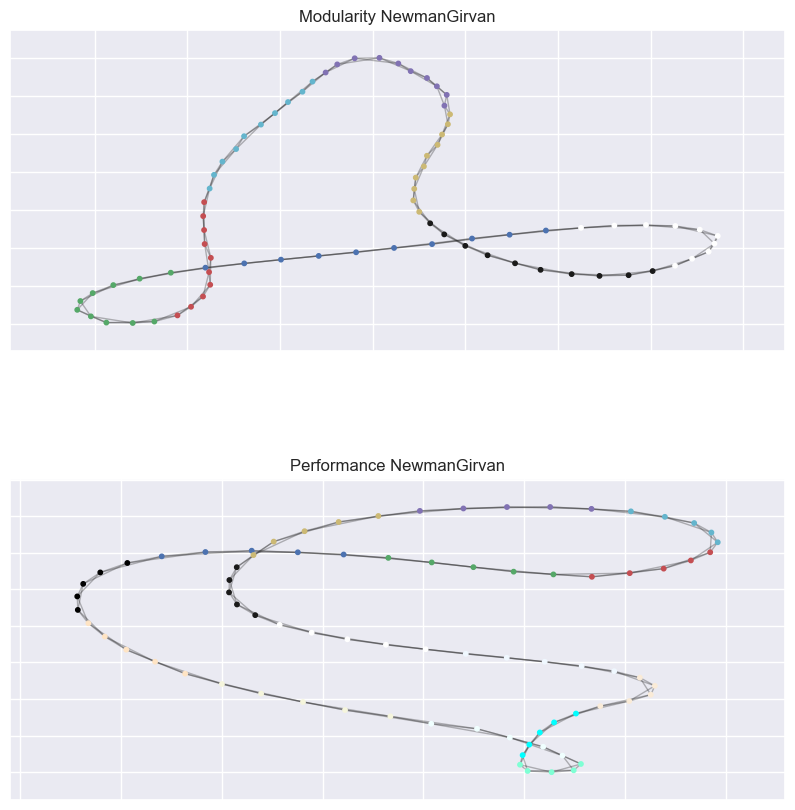

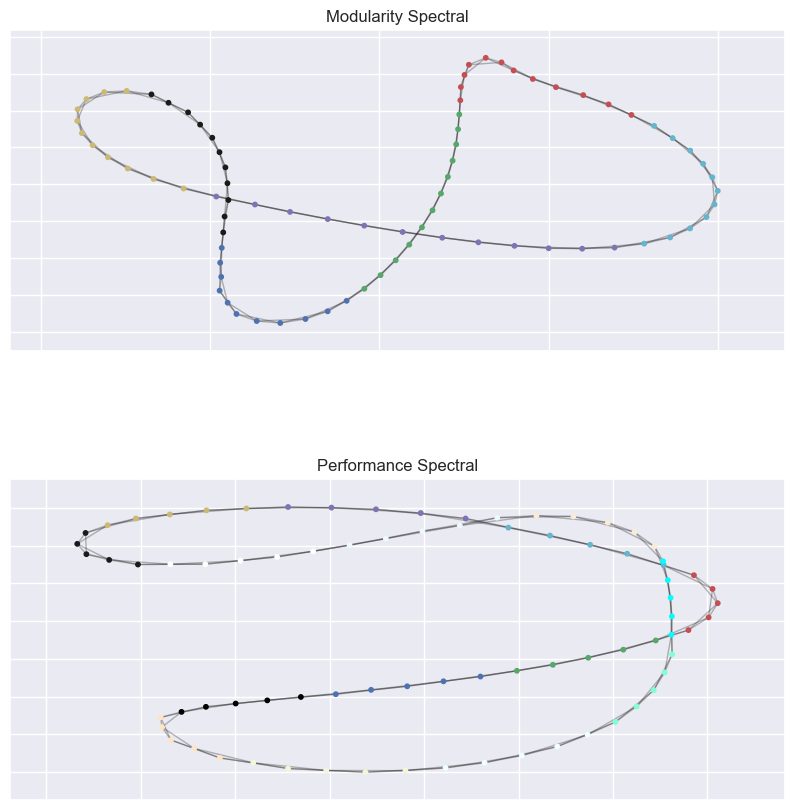

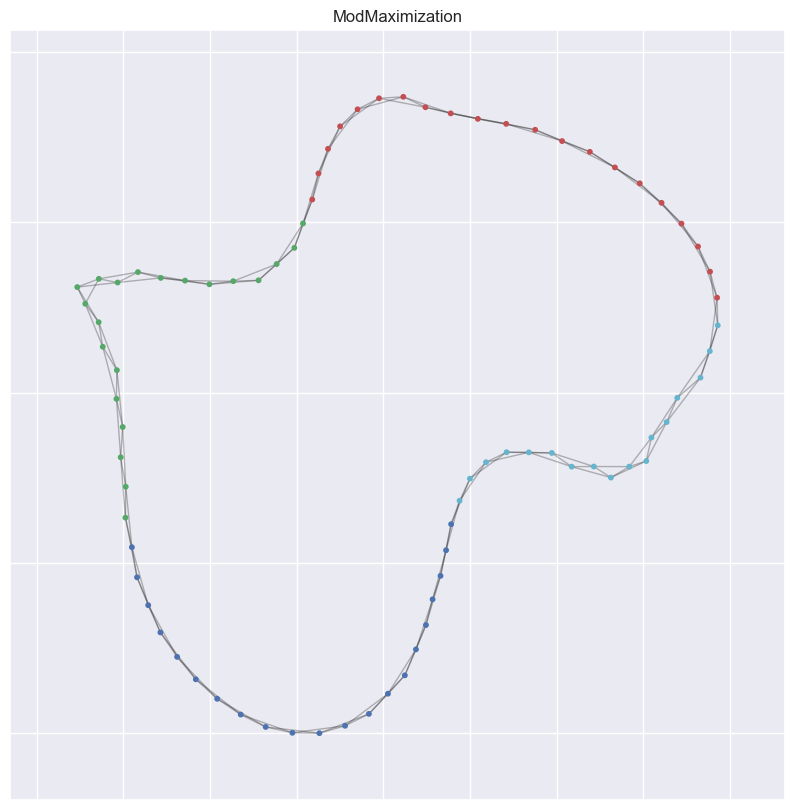

In [268]:
ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(Graphs['REG'],'REG')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'REG',Graphs['REG'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(Graphs['REG'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(Graphs['REG'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(Graphs['REG'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1


for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(Graphs['REG'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(Graphs['REG'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(Graphs['REG'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(Graphs['REG'],ModPartitions[name][0])[1])


#### Οπτικοποίηση κοινοτήτων RGER

NewmanGirvan method :
	Creating partitions for graph RGER ...


49it [00:01, 32.99it/s]


	For graph  RGER  generated  49  partitions and needed  0:00:01.486508  seconds to elapse

Spectral method :
	Creating partitions for graph RGER ...


100%|██████████| 48/48 [00:00<00:00, 199.50it/s]


	For graph  RGER  generated  48  partitions and needed  0:00:00.245163  seconds to elapse

ModMaximization method :
	Creating partitions for graph RGER ...


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.21109444444444445
Lenght: 7
Performance: 0.8949367088607595
=================== Spectral Method ======================
Modularity: -0.003172222222222254
Lenght: 21
Performance: 0.730379746835443
=================== ModMaximization Method ======================
Modularity: 0.28364999999999996
Lenght: 25
Performance: 0.55


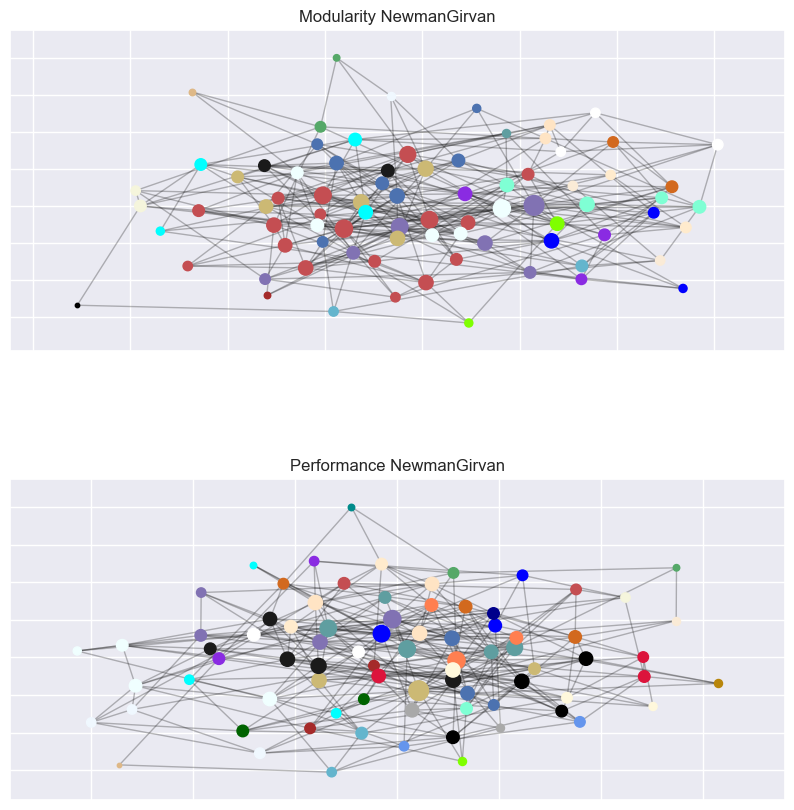

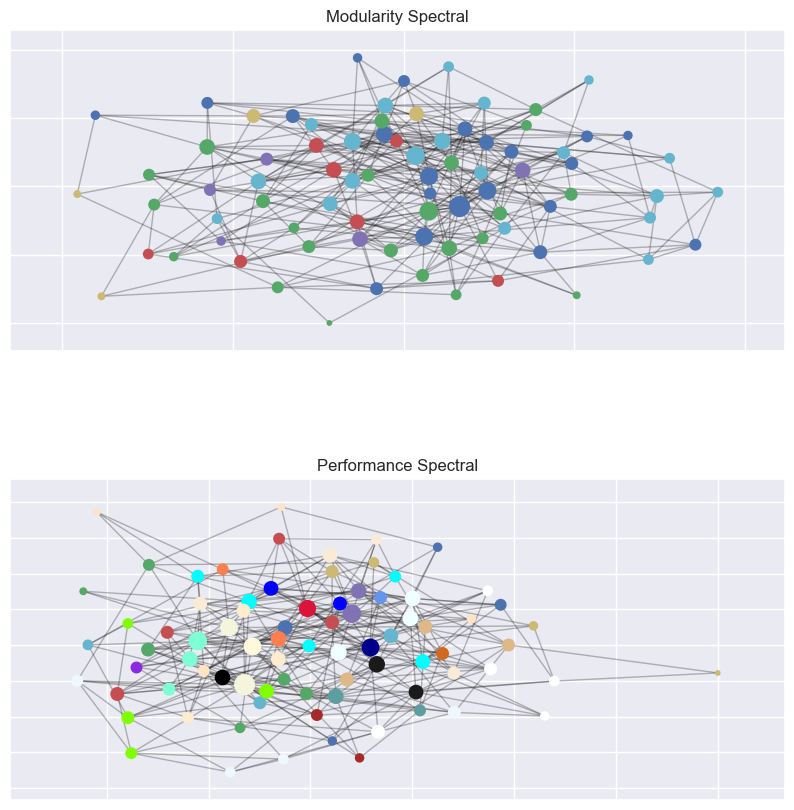

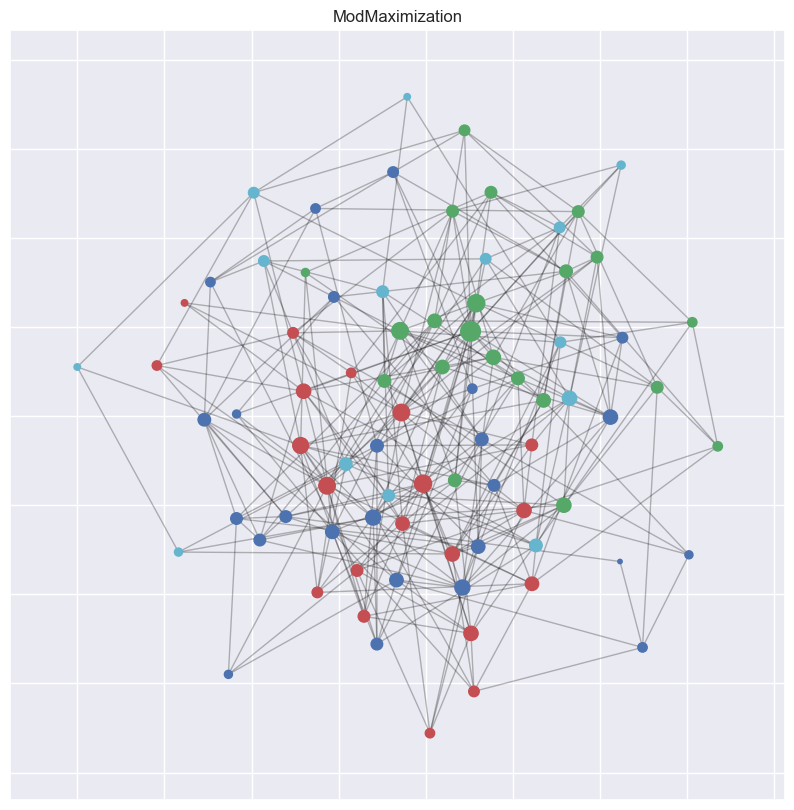

In [269]:
ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(Graphs['RGER'],'RGER')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'RGER',Graphs['RGER'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(Graphs['RGER'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(Graphs['RGER'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(Graphs['RGER'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1

for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(Graphs['RGER'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(Graphs['RGER'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(Graphs['RGER'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(Graphs['RGER'],ModPartitions[name][0])[1])


#### Οπτικοποίηση κοινοτήτων RGG

NewmanGirvan method :
	Creating partitions for graph RGG ...


49it [00:01, 42.33it/s]


	For graph  RGG  generated  49  partitions and needed  0:00:01.159259  seconds to elapse

Spectral method :
	Creating partitions for graph RGG ...


100%|██████████| 48/48 [00:00<00:00, 167.79it/s]


	For graph  RGG  generated  48  partitions and needed  0:00:00.290326  seconds to elapse

ModMaximization method :
	Creating partitions for graph RGG ...


100%|██████████| 4/4 [00:00<00:00, 1181.74it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.5970493827160495
Lenght: 23
Performance: 0.8639240506329114
=================== Spectral Method ======================
Modularity: 0.5789012345679012
Lenght: 23
Performance: 0.8528481012658228
=================== ModMaximization Method ======================
Modularity: 0.5853728395061728
Lenght: 28
Performance: 0.9044444444444445
NewmanGirvan method :
	Creating partitions for graph RGGil ...


49it [00:10,  4.81it/s]


	For graph  RGGil  generated  49  partitions and needed  0:00:10.188148  seconds to elapse

Spectral method :
	Creating partitions for graph RGGil ...


100%|██████████| 48/48 [00:00<00:00, 216.14it/s]


	For graph  RGGil  generated  48  partitions and needed  0:00:00.226680  seconds to elapse

ModMaximization method :
	Creating partitions for graph RGGil ...


100%|██████████| 4/4 [00:00<00:00, 3741.57it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.03197172693633655
Lenght: 41
Performance: 0.6537974683544304
=================== Spectral Method ======================
Modularity: -0.01936935857148461
Lenght: 3
Performance: 0.6816455696202531
=================== ModMaximization Method ======================
Modularity: 0.1235115999320087
Lenght: 30
Performance: 0.4519832985386221


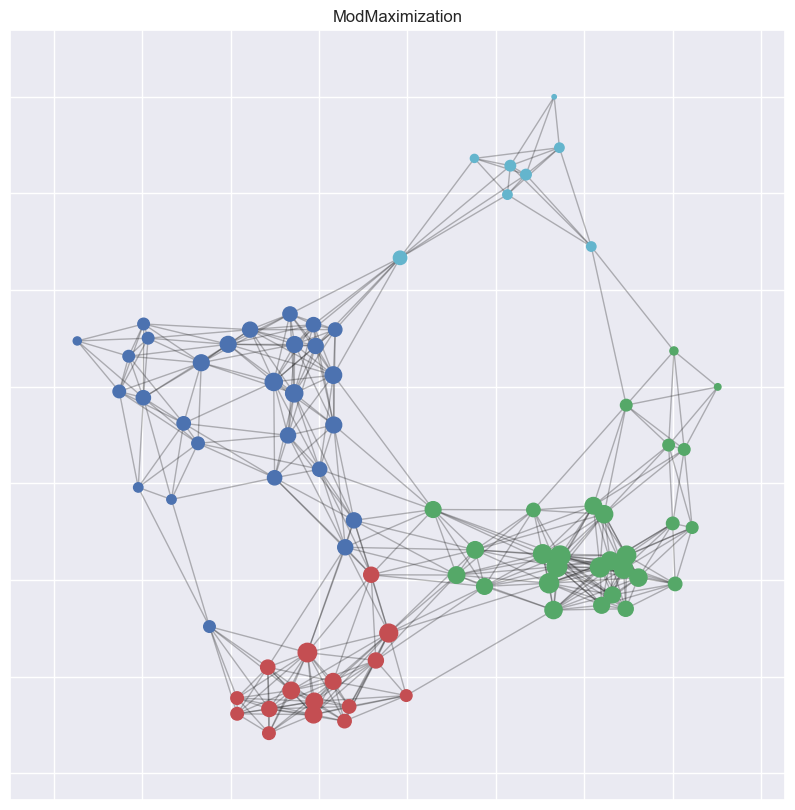

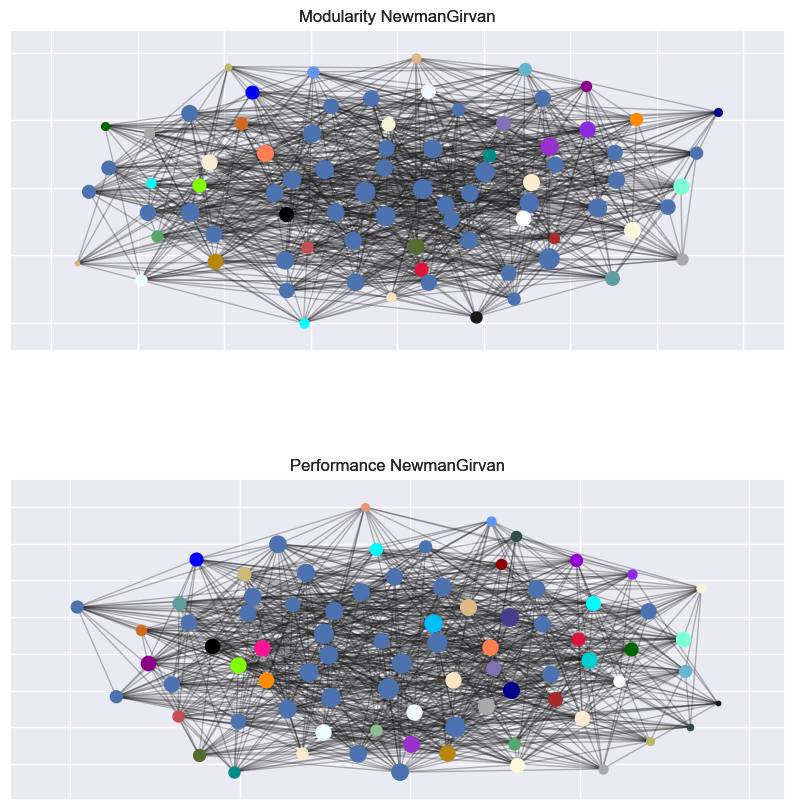

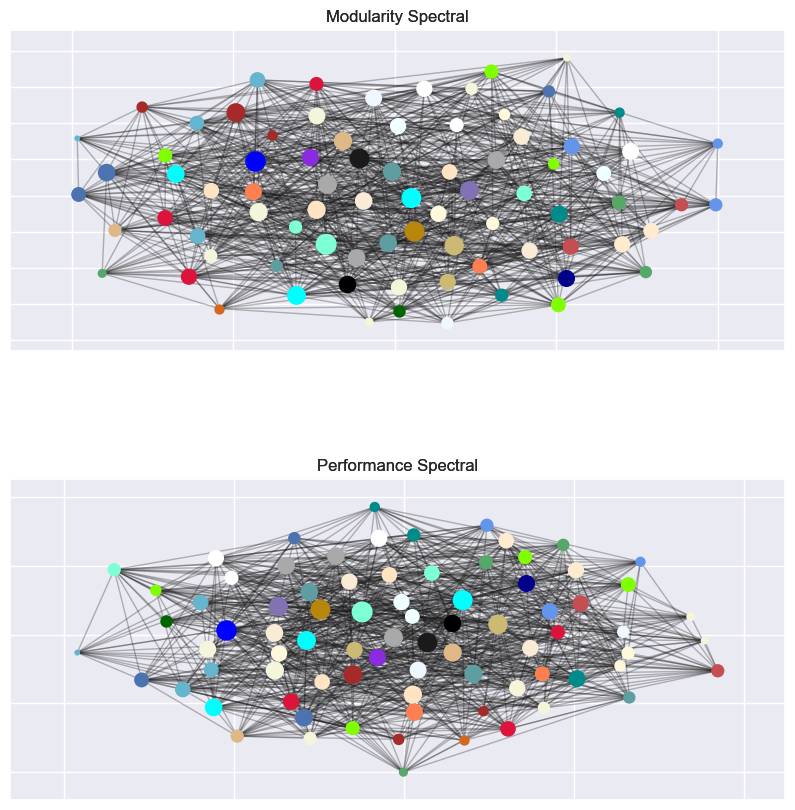

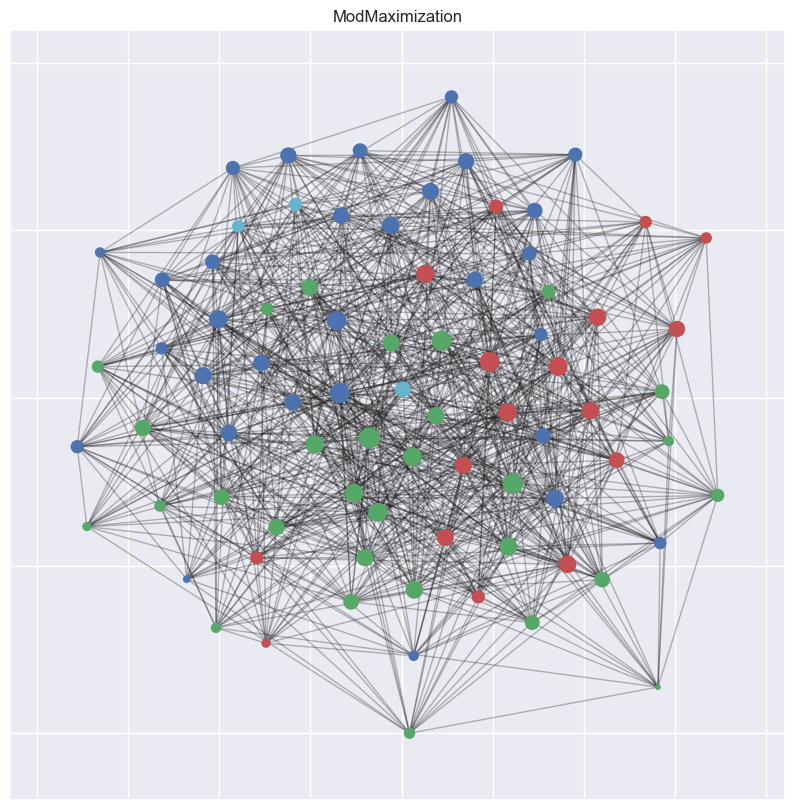

In [270]:

ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(Graphs['RGG'],'RGG')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'RGG',Graphs['RGG'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(Graphs['RGG'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(Graphs['RGG'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(Graphs['RGG'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1

for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(Graphs['RGG'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(Graphs['RGG'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(Graphs['RGG'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(Graphs['RGG'],ModPartitions[name][0])[1])


ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(Graphs['RGGil'],'RGGil')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'RGGil',Graphs['RGGil'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i+4)
        drawPartitions(Graphs['RGGil'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(Graphs['RGGil'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(Graphs['RGGil'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1

for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(Graphs['RGGil'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(Graphs['RGGil'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(Graphs['RGGil'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(Graphs['RGGil'],ModPartitions[name][0])[1])


#### Οπτικοποίηση κοινοτήτων SW

NewmanGirvan method :
	Creating partitions for graph SW ...


49it [00:00, 141.50it/s]


	For graph  SW  generated  49  partitions and needed  0:00:00.347535  seconds to elapse

Spectral method :
	Creating partitions for graph SW ...


100%|██████████| 48/48 [00:00<00:00, 216.01it/s]


	For graph  SW  generated  48  partitions and needed  0:00:00.227593  seconds to elapse

ModMaximization method :
	Creating partitions for graph SW ...


100%|██████████| 8/8 [00:00<00:00, 88069.38it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.5741015625
Lenght: 10
Performance: 0.8930379746835443
=================== Spectral Method ======================
Modularity: 0.38884765624999995
Lenght: 19
Performance: 0.8123417721518987
=================== ModMaximization Method ======================
Modularity: 0.563203125
Lenght: 13
Performance: 0.69375


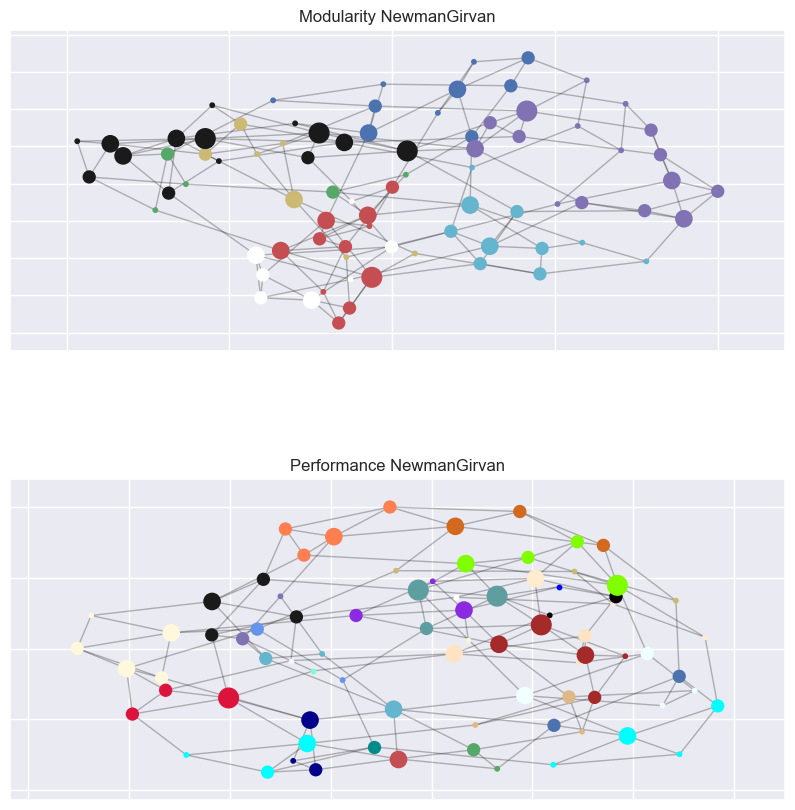

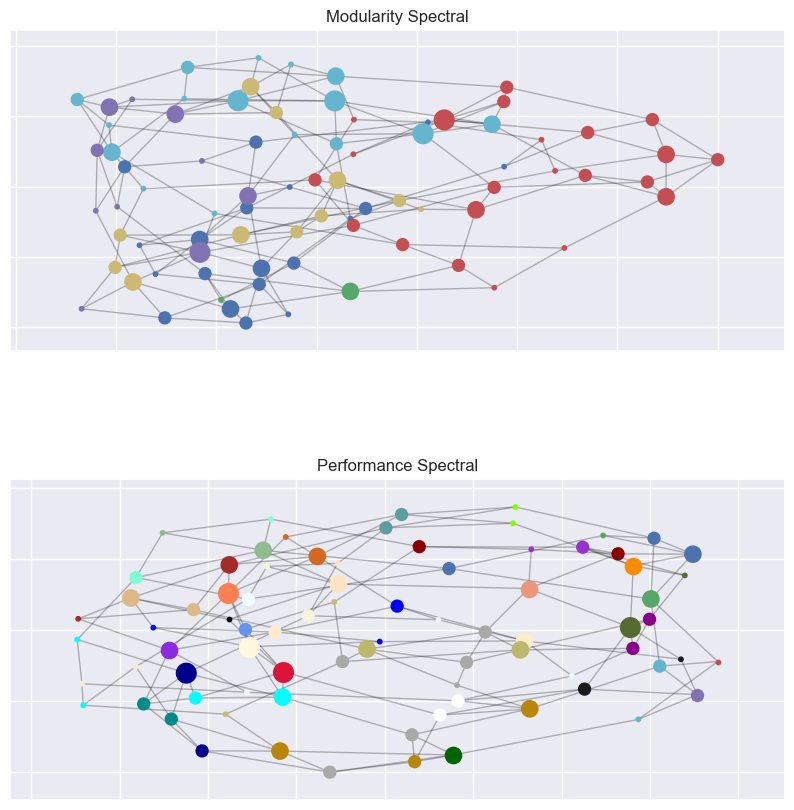

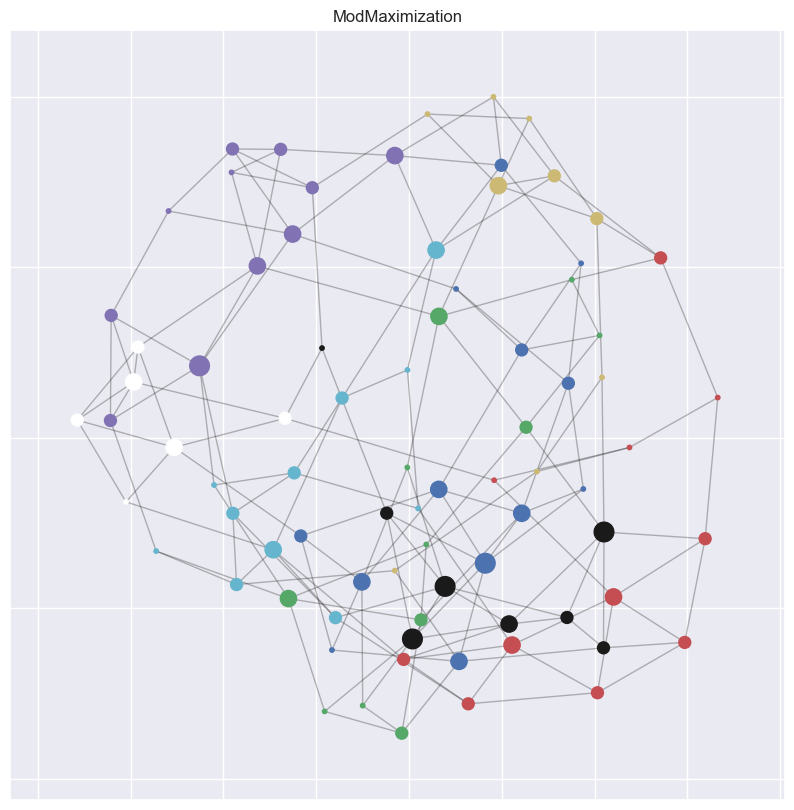

In [271]:
ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(Graphs['SW'],'SW')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'SW',Graphs['SW'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(Graphs['SW'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(Graphs['SW'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(Graphs['SW'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1

for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(Graphs['SW'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(Graphs['SW'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(Graphs['SW'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(Graphs['SW'],ModPartitions[name][0])[1])


#### Οπτικοποίηση κοινοτήτων SF

NewmanGirvan method :
	Creating partitions for graph SF ...


49it [00:01, 33.53it/s]


	For graph  SF  generated  49  partitions and needed  0:00:01.466328  seconds to elapse

Spectral method :
	Creating partitions for graph SF ...


100%|██████████| 48/48 [00:00<00:00, 195.17it/s]


	For graph  SF  generated  48  partitions and needed  0:00:00.250542  seconds to elapse

ModMaximization method :
	Creating partitions for graph SF ...


100%|██████████| 5/5 [00:00<00:00, 1762.31it/s]


=================== NewmanGirvan Method ======================
Modularity: 0.13638331024930742
Lenght: 29
Performance: 0.8468354430379746
=================== Spectral Method ======================
Modularity: 0.08720892486149584
Lenght: 31
Performance: 0.6313291139240507
=================== ModMaximization Method ======================
Modularity: 0.27000194771468145
Lenght: 21
Performance: 0.48355263157894735


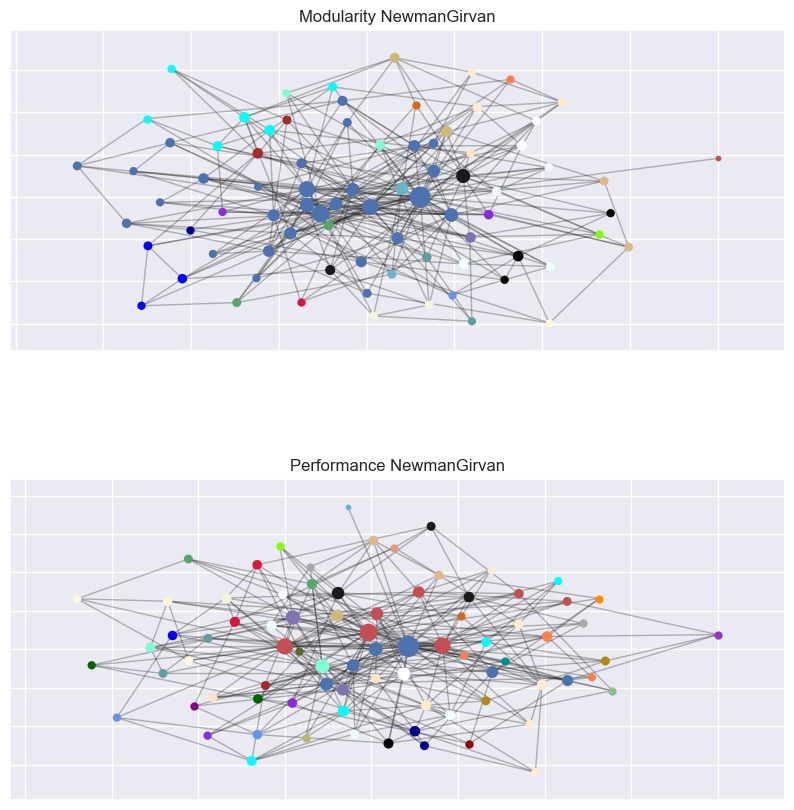

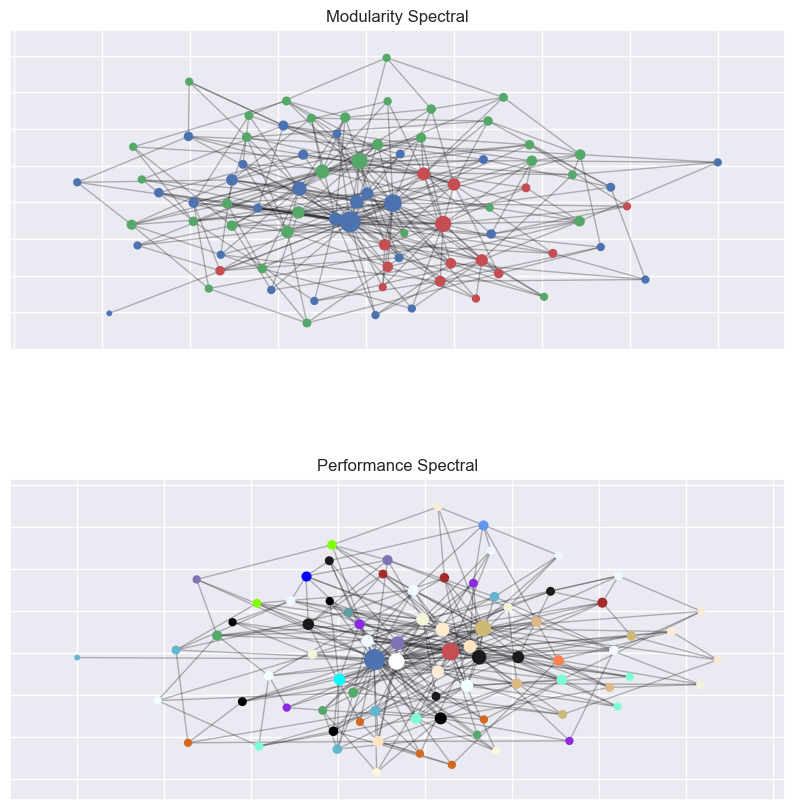

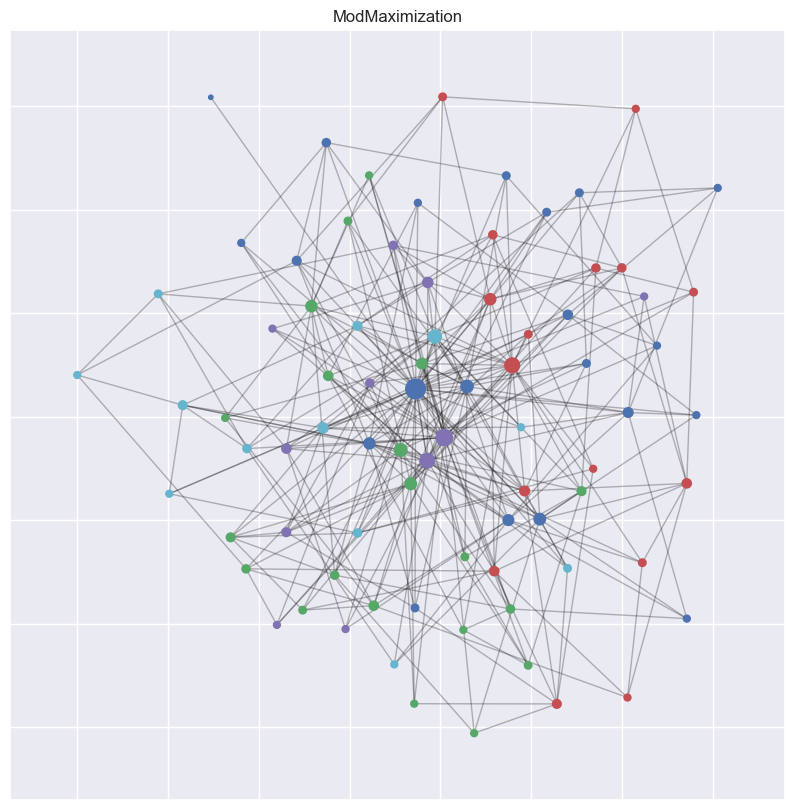

In [272]:
ModPartitions = {}
QualPartitions = {}
for name,method in methods.items():
    if name == 'ModMaximization':
        ModPartitions[name] = ModMaximization(Graphs['SF'],'SF')
    else:
        ModPartitions[name], QualPartitions[name]  = highestPartions(method,'SF',Graphs['SF'],-1)
    
#figure size 
plt.rcParams['figure.figsize'] = [10, 10]


i = 0
for name,method in methods.items():
    if name == 'ModMaximization':
        figure, axis = plt.subplots(1,1,num=i)
        drawPartitions(Graphs['SF'],[ModPartitions[name]], name,axis)
    else:
        figure, axis = plt.subplots(2,1,num=i)
        figure.subplots_adjust(hspace=0.4,wspace=0.4)
        drawPartitions(Graphs['SF'],ModPartitions[name], "Modularity "+name,axis[0])
        drawPartitions(Graphs['SF'],QualPartitions[name], "Performance "+name,axis[1])
    i+=1

for name,method in methods.items():
    print("===================",name,"Method","======================")
    if(name == 'ModMaximization'):
        print("Modularity:",nx.community.modularity(Graphs['SF'],ModPartitions[name]))
        print("Lenght:",len(ModPartitions[name][0]))
        print("Performance:",nx.community.partition_quality(Graphs['SF'],ModPartitions[name])[0])
    else:
        print("Modularity:",nx.community.modularity(Graphs['SF'],ModPartitions[name][0]))
        print("Lenght:",len(ModPartitions[name][0][0]))
        print("Performance:",nx.community.partition_quality(Graphs['SF'],ModPartitions[name][0])[1])
